# Afriat

In [1]:
scan=0.1392

In [2]:
import warnings
import os
import sys
import gc
import warnings

In [3]:
import anndata as ad
import scanpy as sc
import copy
import torch
from pathlib import Path
import networkx as nx
from sklearn.neighbors import kneighbors_graph
import numpy as np
import scanpy as sc
import pandas as pd
import numpy as np
import scipy.stats

sys.path.append("/home/icb/kemal.inecik/work/codes/tardis")
import tardis
tardis.config = tardis.config_server

In [4]:
torch.cuda.is_available()

False

In [5]:
%matplotlib inline
%config InlineBackend.figure_format='retina'
import matplotlib.pyplot as plt
import seaborn as sns

import pickle
_rcparams_path = "/home/icb/kemal.inecik/work/codes/tardis/training/local/figures/rcparams.pickle"
with open(_rcparams_path, 'rb') as file:
    _rcparams = pickle.load(file)
plt.rcParams.update(_rcparams)

In [6]:
adata_file_path = os.path.join(tardis.config.io_directories["processed"], "biolord_afriat.h5ad")
assert os.path.isfile(adata_file_path), f"File not already exist: `{adata_file_path}`"
adata = ad.read_h5ad(adata_file_path)
adata

AnnData object with n_obs × n_vars = 19053 × 5000
    obs: 'mouse', 'experiment', 'time_int', 'time_cat', 'zone', 'status_control'

In [7]:
model_level_metrics = [
    dict(
        metric_identifier = "metric_mi|status_control",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 256,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|zone",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|time_cat",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    ),
    dict(
        metric_identifier = "metric_mi|mouse",
        training_set = ["train"],
        every_n_epoch = 5,
        subsample = 1.0,
        progress_bar = True,
        metric_kwargs = dict(
            variation = "normalized",
            discretization_bins = 128,
            latent_subset=None,
            reduce=np.mean
        )
    )
]

In [8]:
warmup_epoch_range = [6, 48]
dtc_w1 = 100
dtc_w2 = 10

counteractive_minibatch_settings = dict(
    method = "categorical_random",
    method_kwargs = dict(
        within_labels = False,
        within_batch = False,
        within_categorical_covs = None,
        seed = "forward",
    )
)

disentenglement_targets_configurations=[
    dict(
        obs_key = "status_control",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "time_cat",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    ),
    dict(
        obs_key = "zone",
        n_reserved_latent = 8,
        counteractive_minibatch_settings = counteractive_minibatch_settings,
        auxillary_losses = [
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * scan,
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "negative",
                transformation = "inverse", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * scan, 
                method = "mse_z", 
                latent_group = "reserved",
                counteractive_example = "positive",
                transformation = "none",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w2 * 1,
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "negative",
                transformation = "none", 
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
            dict(
                apply = True, 
                target_type="categorical",
                progress_bar = False,
                weight = dtc_w1 * 1, 
                method = "mse_z", 
                latent_group = "unreserved_complete",
                counteractive_example = "positive",
                transformation = "inverse",
                warmup_epoch_range=warmup_epoch_range,
                method_kwargs = {}
            ),
        ]
    )
]

In [9]:
n_epochs_kl_warmup = 600

model_params = dict(
    n_hidden=512,
    n_layers=3, 
    n_latent=(24 + 8 * len(disentenglement_targets_configurations)),
    gene_likelihood = "nb",
    use_batch_norm = "none",
    use_layer_norm = "both",
    dropout_rate = 0.25,
    deeply_inject_disentengled_latents = True,
    include_auxillary_loss = True,
    beta_kl_weight = 0.5,
)

train_params = dict(
    max_epochs=600,
    train_size=0.8,
    batch_size=128,
    check_val_every_n_epoch=10,
    limit_train_batches=1.0, 
    limit_val_batches=1.0,
    learning_rate_monitor=True,
    # early stopping:
    early_stopping=False,
    early_stopping_patience=150,
    early_stopping_monitor="elbo_train",
    plan_kwargs = dict(
        n_epochs_kl_warmup=n_epochs_kl_warmup,
        lr=1e-4,
        weight_decay=1e-4,
        optimizer="AdamW",
        # lr-scheduler:
        reduce_lr_on_plateau=True,
        lr_patience=100,
        lr_scheduler_metric="elbo_train",
    )
)

dataset_params = dict(
    layer=None, 
    labels_key=None,
    batch_key=None,
    categorical_covariate_keys=None,
    disentenglement_targets_configurations=disentenglement_targets_configurations,
    model_level_metrics=model_level_metrics,
    model_level_metrics_helper_covariates=['zone', 'status_control', 'time_cat', 'mouse']
)

tardis.MyModel.setup_anndata(adata, **dataset_params)
dataset_params["adata_path"] = adata_file_path
dataset_params["adata"] = os.path.split(adata_file_path)[1]

# tardis.MyModel.setup_wandb(
#     wandb_configurations=tardis.config.wandb,
#     hyperparams=dict(
#         model_params=model_params,
#         train_params=train_params,
#         dataset_params=dataset_params,
#     )
# )

vae = tardis.MyModel(
    adata,
    **model_params
)
vae.train(**train_params)

dir_path = os.path.join(
    tardis.config.io_directories["models"],
    f"afriat_v2_4_scan_{scan}"
)

vae.save(
    dir_path,
    overwrite=True,
)

/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/scvi/data/fields/_base_field.py:64: UserWarning: adata.X does not contain unnormalized count data. Are you sure this is what you want?
  self.validate_field(adata)


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(


GPU available: False, used: False


TPU available: False, using: 0 TPU cores


IPU available: False, using: 0 IPUs


HPU available: False, using: 0 HPUs


`Trainer(limit_train_batches=1.0)` was configured so 100% of the batches per epoch will be used..


`Trainer(limit_val_batches=1.0)` was configured so 100% of the batches will be used..


/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/lightning/fabric/plugins/environments/slurm.py:168: PossibleUserWarning: The `srun` command is available on your system but is not used. HINT: If your intention is to run Lightning on SLURM, prepend your python command with `srun` like so: srun python /home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_ ...
  rank_zero_warn(
/home/icb/kemal.inecik/tools/apps/mamba/envs/tardis_env/lib/python3.10/site-packages/torch/optim/lr_scheduler.py:28: UserWarning: The verbose parameter is deprecated. Please use get_last_lr() to access the learning rate.
  warnings.warn("The verbose parameter is deprecated. Please use get_last_lr() "


Training:   0%|          | 0/600 [00:00<?, ?it/s]

Epoch 1/600:   0%|          | 0/600 [00:00<?, ?it/s]

/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `training` set. Number of elements in each group: 2567,3301,9375
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `training` set. Number of elements in each group: 2567,2574,1681,3435,1624,3362
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `training` set. Number of elements in each group: 4477,10766
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `status_control` for `validation` set. Number of elements in each group: 638,808,2364
  possible_indices = CachedPossibleGroupDefinitionIndices.get(
/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `time_cat` for `validation` set. Number of elements in each group: 638,628,427,855,425,837
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


/home/icb/kemal.inecik/work/codes/tardis/tardis/_counteractivegenerator.py:237: UserWarning: Possible group definition indices are calculated for `zone` for `validation` set. Number of elements in each group: 1107,2703
  possible_indices = CachedPossibleGroupDefinitionIndices.get(


Epoch 1/600:   0%|          | 1/600 [00:15<2:34:41, 15.49s/it]

Epoch 1/600:   0%|          | 1/600 [00:15<2:34:41, 15.49s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=54.8]

Epoch 2/600:   0%|          | 1/600 [00:15<2:34:41, 15.49s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=54.8]

Epoch 2/600:   0%|          | 2/600 [00:28<2:21:47, 14.23s/it, v_num=1, total_loss_train=3.71e+3, kl_local_train=54.8]

Epoch 2/600:   0%|          | 2/600 [00:28<2:21:47, 14.23s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=85.3]

Epoch 3/600:   0%|          | 2/600 [00:28<2:21:47, 14.23s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=85.3]

Epoch 3/600:   0%|          | 3/600 [00:42<2:17:06, 13.78s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=85.3]

Epoch 3/600:   0%|          | 3/600 [00:42<2:17:06, 13.78s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=87]  

Epoch 4/600:   0%|          | 3/600 [00:42<2:17:06, 13.78s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=87]

Epoch 4/600:   1%|          | 4/600 [00:55<2:16:13, 13.71s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=87]

Epoch 4/600:   1%|          | 4/600 [00:55<2:16:13, 13.71s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 4/600 [00:55<2:16:13, 13.71s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 5/600 [01:10<2:18:23, 13.95s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=82.1]

Epoch 5/600:   1%|          | 5/600 [01:10<2:18:23, 13.95s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=72.9]

Epoch 6/600:   1%|          | 5/600 [01:11<2:18:23, 13.95s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=72.9]

Epoch 6/600:   1%|          | 6/600 [01:25<2:21:29, 14.29s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=72.9]

Epoch 6/600:   1%|          | 6/600 [01:25<2:21:29, 14.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 6/600 [01:25<2:21:29, 14.29s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:38<2:17:25, 13.91s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=53.2, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 7/600:   1%|          | 7/600 [01:38<2:17:25, 13.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|          | 7/600 [01:38<2:17:25, 13.91s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:51<2:14:55, 13.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 8/600:   1%|▏         | 8/600 [01:51<2:14:55, 13.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   1%|▏         | 8/600 [01:51<2:14:55, 13.67s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:04<2:14:06, 13.62s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 9/600:   2%|▏         | 9/600 [02:04<2:14:06, 13.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]  

Epoch 10/600:   2%|▏         | 9/600 [02:04<2:14:06, 13.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:18<2:12:43, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=33, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 10/600:   2%|▏         | 10/600 [02:18<2:12:43, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=40, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 10/600 [02:19<2:12:43, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=40, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:32<2:15:02, 13.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=40, metric_mi|status_control_train=0.0185, metric_mi|zone_train=0.0104, metric_mi|time_cat_train=0.0123, metric_mi|mouse_train=0.0349]

Epoch 11/600:   2%|▏         | 11/600 [02:32<2:15:02, 13.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 12/600:   2%|▏         | 11/600 [02:32<2:15:02, 13.76s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 12/600:   2%|▏         | 12/600 [02:45<2:12:33, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 12/600:   2%|▏         | 12/600 [02:45<2:12:33, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 13/600:   2%|▏         | 12/600 [02:45<2:12:33, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 13/600:   2%|▏         | 13/600 [02:58<2:12:02, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 13/600:   2%|▏         | 13/600 [02:58<2:12:02, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 14/600:   2%|▏         | 13/600 [02:58<2:12:02, 13.50s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 14/600:   2%|▏         | 14/600 [03:12<2:11:20, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 14/600:   2%|▏         | 14/600 [03:12<2:11:20, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 15/600:   2%|▏         | 14/600 [03:12<2:11:20, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 15/600:   2%|▎         | 15/600 [03:25<2:11:06, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=56.2, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 15/600:   2%|▎         | 15/600 [03:25<2:11:06, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 16/600:   2%|▎         | 15/600 [03:26<2:11:06, 13.45s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 16/600:   3%|▎         | 16/600 [03:39<2:13:32, 13.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=58.5, metric_mi|status_control_train=0.0267, metric_mi|zone_train=0.0824, metric_mi|time_cat_train=0.0209, metric_mi|mouse_train=0.0481]

Epoch 16/600:   3%|▎         | 16/600 [03:39<2:13:32, 13.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 17/600:   3%|▎         | 16/600 [03:39<2:13:32, 13.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 17/600:   3%|▎         | 17/600 [03:53<2:11:49, 13.57s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=63.3, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 17/600:   3%|▎         | 17/600 [03:53<2:11:49, 13.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 18/600:   3%|▎         | 17/600 [03:53<2:11:49, 13.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 18/600:   3%|▎         | 18/600 [04:06<2:10:43, 13.48s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=69.9, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 18/600:   3%|▎         | 18/600 [04:06<2:10:43, 13.48s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 19/600:   3%|▎         | 18/600 [04:06<2:10:43, 13.48s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 19/600:   3%|▎         | 19/600 [04:19<2:10:13, 13.45s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=74.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 19/600:   3%|▎         | 19/600 [04:19<2:10:13, 13.45s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 20/600:   3%|▎         | 19/600 [04:19<2:10:13, 13.45s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 20/600:   3%|▎         | 20/600 [04:32<2:09:13, 13.37s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.7, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 20/600:   3%|▎         | 20/600 [04:32<2:09:13, 13.37s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.5, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 21/600:   3%|▎         | 20/600 [04:34<2:09:13, 13.37s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.5, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 21/600:   4%|▎         | 21/600 [04:47<2:12:34, 13.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=87.5, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0674, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0658]

Epoch 21/600:   4%|▎         | 21/600 [04:47<2:12:34, 13.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=95.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 22/600:   4%|▎         | 21/600 [04:47<2:12:34, 13.74s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=95.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 22/600:   4%|▎         | 22/600 [05:01<2:11:31, 13.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=95.1, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 22/600:   4%|▎         | 22/600 [05:01<2:11:31, 13.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857] 

Epoch 23/600:   4%|▎         | 22/600 [05:01<2:11:31, 13.65s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 23/600:   4%|▍         | 23/600 [05:14<2:10:12, 13.54s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=102, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 23/600:   4%|▍         | 23/600 [05:14<2:10:12, 13.54s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 24/600:   4%|▍         | 23/600 [05:14<2:10:12, 13.54s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 24/600:   4%|▍         | 24/600 [05:27<2:08:36, 13.40s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 24/600:   4%|▍         | 24/600 [05:27<2:08:36, 13.40s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 25/600:   4%|▍         | 24/600 [05:27<2:08:36, 13.40s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 25/600:   4%|▍         | 25/600 [05:40<2:07:25, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=117, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 25/600:   4%|▍         | 25/600 [05:40<2:07:25, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 26/600:   4%|▍         | 25/600 [05:41<2:07:25, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 26/600:   4%|▍         | 26/600 [05:55<2:11:13, 13.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0541, metric_mi|zone_train=0.0684, metric_mi|time_cat_train=0.0673, metric_mi|mouse_train=0.0857]

Epoch 26/600:   4%|▍         | 26/600 [05:55<2:11:13, 13.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108] 

Epoch 27/600:   4%|▍         | 26/600 [05:55<2:11:13, 13.72s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 27/600 [06:08<2:09:12, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=121, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 27/600:   4%|▍         | 27/600 [06:08<2:09:12, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 28/600:   4%|▍         | 27/600 [06:08<2:09:12, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 28/600:   5%|▍         | 28/600 [06:21<2:08:19, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=122, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 28/600:   5%|▍         | 28/600 [06:21<2:08:19, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=123, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 28/600 [06:21<2:08:19, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=123, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 29/600 [06:34<2:06:32, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=123, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 29/600:   5%|▍         | 29/600 [06:34<2:06:32, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▍         | 29/600 [06:34<2:06:32, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▌         | 30/600 [06:47<2:06:12, 13.29s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=119, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 30/600:   5%|▌         | 30/600 [06:47<2:06:12, 13.29s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 30/600 [06:49<2:06:12, 13.29s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 31/600 [07:02<2:10:39, 13.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=115, metric_mi|status_control_train=0.0835, metric_mi|zone_train=0.0773, metric_mi|time_cat_train=0.0996, metric_mi|mouse_train=0.108]

Epoch 31/600:   5%|▌         | 31/600 [07:02<2:10:39, 13.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]  

Epoch 32/600:   5%|▌         | 31/600 [07:02<2:10:39, 13.78s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 32/600:   5%|▌         | 32/600 [07:16<2:09:36, 13.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=110, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 32/600:   5%|▌         | 32/600 [07:16<2:09:36, 13.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 33/600:   5%|▌         | 32/600 [07:16<2:09:36, 13.69s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 33/600:   6%|▌         | 33/600 [07:29<2:07:39, 13.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=105, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 33/600:   6%|▌         | 33/600 [07:29<2:07:39, 13.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 33/600 [07:29<2:07:39, 13.51s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 34/600 [07:42<2:06:04, 13.36s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=102, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 34/600:   6%|▌         | 34/600 [07:42<2:06:04, 13.36s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 34/600 [07:42<2:06:04, 13.36s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 35/600 [07:55<2:05:09, 13.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 35/600:   6%|▌         | 35/600 [07:55<2:05:09, 13.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 35/600 [07:56<2:05:09, 13.29s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 36/600 [08:09<2:08:05, 13.63s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=100, metric_mi|status_control_train=0.0944, metric_mi|zone_train=0.111, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.113]

Epoch 36/600:   6%|▌         | 36/600 [08:09<2:08:05, 13.63s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 36/600 [08:09<2:08:05, 13.63s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [08:22<2:06:34, 13.49s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 37/600:   6%|▌         | 37/600 [08:22<2:06:34, 13.49s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▌         | 37/600 [08:22<2:06:34, 13.49s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:36<2:06:29, 13.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 38/600:   6%|▋         | 38/600 [08:36<2:06:29, 13.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 38/600 [08:36<2:06:29, 13.50s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:49<2:05:59, 13.47s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=99.5, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 39/600:   6%|▋         | 39/600 [08:49<2:05:59, 13.47s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118] 

Epoch 40/600:   6%|▋         | 39/600 [08:49<2:05:59, 13.47s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [09:03<2:05:08, 13.41s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.8, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 40/600:   7%|▋         | 40/600 [09:03<2:05:08, 13.41s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 40/600 [09:04<2:05:08, 13.41s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [09:17<2:07:29, 13.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.118, metric_mi|mouse_train=0.118]

Epoch 41/600:   7%|▋         | 41/600 [09:17<2:07:29, 13.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 41/600 [09:17<2:07:29, 13.68s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 42/600 [09:30<2:06:11, 13.57s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=98.9, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 42/600:   7%|▋         | 42/600 [09:30<2:06:11, 13.57s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 42/600 [09:30<2:06:11, 13.57s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 43/600 [09:44<2:05:23, 13.51s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=99.7, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 43/600:   7%|▋         | 43/600 [09:44<2:05:23, 13.51s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122] 

Epoch 44/600:   7%|▋         | 43/600 [09:44<2:05:23, 13.51s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 44/600 [09:57<2:04:06, 13.39s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 44/600:   7%|▋         | 44/600 [09:57<2:04:06, 13.39s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 45/600:   7%|▋         | 44/600 [09:57<2:04:06, 13.39s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 45/600:   8%|▊         | 45/600 [10:10<2:03:10, 13.32s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 45/600:   8%|▊         | 45/600 [10:10<2:03:10, 13.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 45/600 [10:11<2:03:10, 13.32s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 46/600 [10:24<2:06:21, 13.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=100, metric_mi|status_control_train=0.122, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.125, metric_mi|mouse_train=0.122]

Epoch 46/600:   8%|▊         | 46/600 [10:24<2:06:21, 13.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 47/600:   8%|▊         | 46/600 [10:24<2:06:21, 13.68s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 47/600:   8%|▊         | 47/600 [10:38<2:05:34, 13.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 47/600:   8%|▊         | 47/600 [10:38<2:05:34, 13.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 48/600:   8%|▊         | 47/600 [10:38<2:05:34, 13.62s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 48/600:   8%|▊         | 48/600 [10:51<2:04:46, 13.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=102, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 48/600:   8%|▊         | 48/600 [10:51<2:04:46, 13.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 49/600:   8%|▊         | 48/600 [10:51<2:04:46, 13.56s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 49/600:   8%|▊         | 49/600 [11:04<2:03:13, 13.42s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 49/600:   8%|▊         | 49/600 [11:04<2:03:13, 13.42s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 50/600:   8%|▊         | 49/600 [11:04<2:03:13, 13.42s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 50/600:   8%|▊         | 50/600 [11:17<2:01:54, 13.30s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=101, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 50/600:   8%|▊         | 50/600 [11:17<2:01:54, 13.30s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=99.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 51/600:   8%|▊         | 50/600 [11:19<2:01:54, 13.30s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=99.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 51/600:   8%|▊         | 51/600 [11:32<2:05:56, 13.76s/it, v_num=1, total_loss_train=3.22e+3, kl_local_train=99.8, metric_mi|status_control_train=0.154, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.131, metric_mi|mouse_train=0.125]

Epoch 51/600:   8%|▊         | 51/600 [11:32<2:05:56, 13.76s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=98.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128] 

Epoch 52/600:   8%|▊         | 51/600 [11:32<2:05:56, 13.76s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=98.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|▊         | 52/600 [11:46<2:04:44, 13.66s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=98.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 52/600:   9%|▊         | 52/600 [11:46<2:04:44, 13.66s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|▊         | 52/600 [11:46<2:04:44, 13.66s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|▉         | 53/600 [11:59<2:03:54, 13.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=97.6, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 53/600:   9%|▉         | 53/600 [11:59<2:03:54, 13.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|▉         | 53/600 [11:59<2:03:54, 13.59s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|▉         | 54/600 [12:12<2:01:20, 13.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=96.2, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 54/600:   9%|▉         | 54/600 [12:12<2:01:20, 13.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|▉         | 54/600 [12:12<2:01:20, 13.33s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|▉         | 55/600 [12:24<1:57:35, 12.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=95.7, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 55/600:   9%|▉         | 55/600 [12:24<1:57:35, 12.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|▉         | 55/600 [12:25<1:57:35, 12.94s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|▉         | 56/600 [12:37<1:58:52, 13.11s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94.9, metric_mi|status_control_train=0.17, metric_mi|zone_train=0.136, metric_mi|time_cat_train=0.136, metric_mi|mouse_train=0.128]

Epoch 56/600:   9%|▉         | 56/600 [12:37<1:58:52, 13.11s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129] 

Epoch 57/600:   9%|▉         | 56/600 [12:37<1:58:52, 13.11s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [12:49<1:55:45, 12.79s/it, v_num=1, total_loss_train=3.21e+3, kl_local_train=94, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 57/600:  10%|▉         | 57/600 [12:49<1:55:45, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 57/600 [12:49<1:55:45, 12.79s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [13:01<1:53:24, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=93.3, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 58/600:  10%|▉         | 58/600 [13:01<1:53:24, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 58/600 [13:01<1:53:24, 12.55s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [13:13<1:51:36, 12.38s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=92.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 59/600:  10%|▉         | 59/600 [13:13<1:51:36, 12.38s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|▉         | 59/600 [13:13<1:51:36, 12.38s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [13:26<1:51:13, 12.36s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=91.6, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 60/600:  10%|█         | 60/600 [13:26<1:51:13, 12.36s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 60/600 [13:27<1:51:13, 12.36s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [13:39<1:53:44, 12.66s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=90.2, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.135, metric_mi|time_cat_train=0.138, metric_mi|mouse_train=0.129]

Epoch 61/600:  10%|█         | 61/600 [13:39<1:53:44, 12.66s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 62/600:  10%|█         | 61/600 [13:39<1:53:44, 12.66s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 62/600:  10%|█         | 62/600 [13:52<1:54:10, 12.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 62/600:  10%|█         | 62/600 [13:52<1:54:10, 12.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 63/600:  10%|█         | 62/600 [13:52<1:54:10, 12.73s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 63/600:  10%|█         | 63/600 [14:05<1:54:46, 12.82s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=89.1, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 63/600:  10%|█         | 63/600 [14:05<1:54:46, 12.82s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 64/600:  10%|█         | 63/600 [14:05<1:54:46, 12.82s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 64/600:  11%|█         | 64/600 [14:18<1:54:56, 12.87s/it, v_num=1, total_loss_train=3.2e+3, kl_local_train=87.4, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 64/600:  11%|█         | 64/600 [14:18<1:54:56, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 65/600:  11%|█         | 64/600 [14:18<1:54:56, 12.87s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 65/600:  11%|█         | 65/600 [14:31<1:55:50, 12.99s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=88.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 65/600:  11%|█         | 65/600 [14:31<1:55:50, 12.99s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 66/600:  11%|█         | 65/600 [14:33<1:55:50, 12.99s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 66/600:  11%|█         | 66/600 [14:46<1:59:58, 13.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.7, metric_mi|status_control_train=0.179, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.137, metric_mi|mouse_train=0.128]

Epoch 66/600:  11%|█         | 66/600 [14:46<1:59:58, 13.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|█         | 66/600 [14:46<1:59:58, 13.48s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|█         | 67/600 [14:59<1:59:13, 13.42s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 67/600:  11%|█         | 67/600 [14:59<1:59:13, 13.42s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|█         | 67/600 [14:59<1:59:13, 13.42s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|█▏        | 68/600 [15:13<1:58:50, 13.40s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.6, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 68/600:  11%|█▏        | 68/600 [15:13<1:58:50, 13.40s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 69/600:  11%|█▏        | 68/600 [15:13<1:58:50, 13.40s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 69/600:  12%|█▏        | 69/600 [15:26<1:57:43, 13.30s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=86.1, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 69/600:  12%|█▏        | 69/600 [15:26<1:57:43, 13.30s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]  

Epoch 70/600:  12%|█▏        | 69/600 [15:26<1:57:43, 13.30s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|█▏        | 70/600 [15:39<1:56:38, 13.21s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=85, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 70/600:  12%|█▏        | 70/600 [15:39<1:56:38, 13.21s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|█▏        | 70/600 [15:40<1:56:38, 13.21s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|█▏        | 71/600 [15:53<2:00:07, 13.62s/it, v_num=1, total_loss_train=3.19e+3, kl_local_train=84.3, metric_mi|status_control_train=0.177, metric_mi|zone_train=0.133, metric_mi|time_cat_train=0.135, metric_mi|mouse_train=0.126]

Epoch 71/600:  12%|█▏        | 71/600 [15:53<2:00:07, 13.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|█▏        | 71/600 [15:53<2:00:07, 13.62s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|█▏        | 72/600 [16:07<1:59:12, 13.55s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.8, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 72/600:  12%|█▏        | 72/600 [16:07<1:59:12, 13.55s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|█▏        | 72/600 [16:07<1:59:12, 13.55s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|█▏        | 73/600 [16:20<1:58:15, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83.1, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 73/600:  12%|█▏        | 73/600 [16:20<1:58:15, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]  

Epoch 74/600:  12%|█▏        | 73/600 [16:20<1:58:15, 13.46s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|█▏        | 74/600 [16:33<1:56:35, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=83, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 74/600:  12%|█▏        | 74/600 [16:33<1:56:35, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|█▏        | 74/600 [16:33<1:56:35, 13.30s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|█▎        | 75/600 [16:46<1:55:38, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=82, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 75/600:  12%|█▎        | 75/600 [16:46<1:55:38, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 76/600:  12%|█▎        | 75/600 [16:47<1:55:38, 13.22s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 76/600:  13%|█▎        | 76/600 [17:01<1:59:41, 13.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.7, metric_mi|status_control_train=0.175, metric_mi|zone_train=0.132, metric_mi|time_cat_train=0.134, metric_mi|mouse_train=0.125]

Epoch 76/600:  13%|█▎        | 76/600 [17:01<1:59:41, 13.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 77/600:  13%|█▎        | 76/600 [17:01<1:59:41, 13.71s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 77/600:  13%|█▎        | 77/600 [17:14<1:58:54, 13.64s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=81.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 77/600:  13%|█▎        | 77/600 [17:14<1:58:54, 13.64s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 78/600:  13%|█▎        | 77/600 [17:14<1:58:54, 13.64s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 78/600:  13%|█▎        | 78/600 [17:27<1:57:40, 13.53s/it, v_num=1, total_loss_train=3.18e+3, kl_local_train=80.8, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 78/600:  13%|█▎        | 78/600 [17:27<1:57:40, 13.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 79/600:  13%|█▎        | 78/600 [17:27<1:57:40, 13.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 79/600:  13%|█▎        | 79/600 [17:41<1:57:03, 13.48s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=80.3, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 79/600:  13%|█▎        | 79/600 [17:41<1:57:03, 13.48s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 80/600:  13%|█▎        | 79/600 [17:41<1:57:03, 13.48s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 80/600:  13%|█▎        | 80/600 [17:55<1:57:37, 13.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.9, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 80/600:  13%|█▎        | 80/600 [17:55<1:57:37, 13.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 81/600:  13%|█▎        | 80/600 [17:56<1:57:37, 13.57s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 81/600:  14%|█▎        | 81/600 [18:09<1:58:53, 13.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=79.4, metric_mi|status_control_train=0.174, metric_mi|zone_train=0.131, metric_mi|time_cat_train=0.133, metric_mi|mouse_train=0.124]

Epoch 81/600:  14%|█▎        | 81/600 [18:09<1:58:53, 13.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123] 

Epoch 82/600:  14%|█▎        | 81/600 [18:09<1:58:53, 13.75s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 82/600:  14%|█▎        | 82/600 [18:22<1:56:51, 13.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 82/600:  14%|█▎        | 82/600 [18:22<1:56:51, 13.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 83/600:  14%|█▎        | 82/600 [18:22<1:56:51, 13.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 83/600:  14%|█▍        | 83/600 [18:35<1:56:14, 13.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.3, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 83/600:  14%|█▍        | 83/600 [18:35<1:56:14, 13.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 84/600:  14%|█▍        | 83/600 [18:35<1:56:14, 13.49s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 84/600:  14%|█▍        | 84/600 [18:48<1:55:45, 13.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=78.2, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 84/600:  14%|█▍        | 84/600 [18:48<1:55:45, 13.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 85/600:  14%|█▍        | 84/600 [18:48<1:55:45, 13.46s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 85/600:  14%|█▍        | 85/600 [19:02<1:55:11, 13.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.8, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 85/600:  14%|█▍        | 85/600 [19:02<1:55:11, 13.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 86/600:  14%|█▍        | 85/600 [19:03<1:55:11, 13.42s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 86/600:  14%|█▍        | 86/600 [19:16<1:57:19, 13.69s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=77.4, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.13, metric_mi|time_cat_train=0.132, metric_mi|mouse_train=0.123]

Epoch 86/600:  14%|█▍        | 86/600 [19:16<1:57:19, 13.69s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 86/600 [19:16<1:57:19, 13.69s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 87/600 [19:29<1:55:43, 13.53s/it, v_num=1, total_loss_train=3.17e+3, kl_local_train=76.4, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 87/600:  14%|█▍        | 87/600 [19:29<1:55:43, 13.53s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 88/600:  14%|█▍        | 87/600 [19:29<1:55:43, 13.53s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|█▍        | 88/600 [19:43<1:54:56, 13.47s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.8, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 88/600:  15%|█▍        | 88/600 [19:43<1:54:56, 13.47s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 88/600 [19:43<1:54:56, 13.47s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 89/600 [19:56<1:54:23, 13.43s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=76.3, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 89/600:  15%|█▍        | 89/600 [19:56<1:54:23, 13.43s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▍        | 89/600 [19:56<1:54:23, 13.43s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▌        | 90/600 [20:09<1:53:20, 13.33s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.6, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 90/600:  15%|█▌        | 90/600 [20:09<1:53:20, 13.33s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 90/600 [20:10<1:53:20, 13.33s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 91/600 [20:23<1:55:41, 13.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.7, metric_mi|status_control_train=0.173, metric_mi|zone_train=0.129, metric_mi|time_cat_train=0.13, metric_mi|mouse_train=0.122]

Epoch 91/600:  15%|█▌        | 91/600 [20:23<1:55:41, 13.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 91/600 [20:23<1:55:41, 13.64s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 92/600 [20:37<1:54:43, 13.55s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=75.1, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 92/600:  15%|█▌        | 92/600 [20:37<1:54:43, 13.55s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  15%|█▌        | 92/600 [20:37<1:54:43, 13.55s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|█▌        | 93/600 [20:50<1:53:13, 13.40s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.9, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 93/600:  16%|█▌        | 93/600 [20:50<1:53:13, 13.40s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 93/600 [20:50<1:53:13, 13.40s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 94/600 [21:03<1:51:54, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.7, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 94/600:  16%|█▌        | 94/600 [21:03<1:51:54, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 94/600 [21:03<1:51:54, 13.27s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 95/600 [21:16<1:51:20, 13.23s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=74.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 95/600:  16%|█▌        | 95/600 [21:16<1:51:20, 13.23s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 95/600 [21:17<1:51:20, 13.23s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 96/600 [21:30<1:54:23, 13.62s/it, v_num=1, total_loss_train=3.16e+3, kl_local_train=73.6, metric_mi|status_control_train=0.172, metric_mi|zone_train=0.128, metric_mi|time_cat_train=0.127, metric_mi|mouse_train=0.12]

Epoch 96/600:  16%|█▌        | 96/600 [21:30<1:54:23, 13.62s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|█▌        | 96/600 [21:30<1:54:23, 13.62s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|█▌        | 97/600 [21:44<1:53:28, 13.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.5, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 97/600:  16%|█▌        | 97/600 [21:44<1:53:28, 13.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|█▌        | 97/600 [21:44<1:53:28, 13.54s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|█▋        | 98/600 [21:57<1:52:38, 13.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.3, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 98/600:  16%|█▋        | 98/600 [21:57<1:52:38, 13.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|█▋        | 98/600 [21:57<1:52:38, 13.46s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|█▋        | 99/600 [22:10<1:51:14, 13.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=73.2, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 99/600:  16%|█▋        | 99/600 [22:10<1:51:14, 13.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 100/600:  16%|█▋        | 99/600 [22:10<1:51:14, 13.32s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 100/600:  17%|█▋        | 100/600 [22:23<1:50:12, 13.22s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=72.4, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 100/600:  17%|█▋        | 100/600 [22:23<1:50:12, 13.22s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|█▋        | 100/600 [22:24<1:50:12, 13.22s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|█▋        | 101/600 [22:38<1:53:51, 13.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.6, metric_mi|status_control_train=0.168, metric_mi|zone_train=0.127, metric_mi|time_cat_train=0.122, metric_mi|mouse_train=0.116]

Epoch 101/600:  17%|█▋        | 101/600 [22:38<1:53:51, 13.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 102/600:  17%|█▋        | 101/600 [22:38<1:53:51, 13.69s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 102/600:  17%|█▋        | 102/600 [22:51<1:52:43, 13.58s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.7, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 102/600:  17%|█▋        | 102/600 [22:51<1:52:43, 13.58s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 103/600:  17%|█▋        | 102/600 [22:51<1:52:43, 13.58s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 103/600:  17%|█▋        | 103/600 [23:05<1:51:52, 13.51s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 103/600:  17%|█▋        | 103/600 [23:05<1:51:52, 13.51s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]  

Epoch 104/600:  17%|█▋        | 103/600 [23:05<1:51:52, 13.51s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 104/600:  17%|█▋        | 104/600 [23:18<1:51:20, 13.47s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=71, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 104/600:  17%|█▋        | 104/600 [23:18<1:51:20, 13.47s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 105/600:  17%|█▋        | 104/600 [23:18<1:51:20, 13.47s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 105/600:  18%|█▊        | 105/600 [23:31<1:50:28, 13.39s/it, v_num=1, total_loss_train=3.15e+3, kl_local_train=70.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 105/600:  18%|█▊        | 105/600 [23:31<1:50:28, 13.39s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 106/600:  18%|█▊        | 105/600 [23:33<1:50:28, 13.39s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 106/600:  18%|█▊        | 106/600 [23:46<1:53:24, 13.77s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.126, metric_mi|time_cat_train=0.117, metric_mi|mouse_train=0.114]

Epoch 106/600:  18%|█▊        | 106/600 [23:46<1:53:24, 13.77s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 106/600 [23:46<1:53:24, 13.77s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 107/600 [23:59<1:51:00, 13.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 107/600:  18%|█▊        | 107/600 [23:59<1:51:00, 13.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]  

Epoch 108/600:  18%|█▊        | 107/600 [23:59<1:51:00, 13.51s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 108/600 [24:12<1:50:25, 13.47s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=70, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 108/600:  18%|█▊        | 108/600 [24:12<1:50:25, 13.47s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 108/600 [24:12<1:50:25, 13.47s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 109/600 [24:25<1:49:06, 13.33s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 109/600:  18%|█▊        | 109/600 [24:25<1:49:06, 13.33s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 109/600 [24:25<1:49:06, 13.33s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 110/600 [24:38<1:48:53, 13.33s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 110/600:  18%|█▊        | 110/600 [24:38<1:48:53, 13.33s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 110/600 [24:40<1:48:53, 13.33s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 111/600 [24:53<1:51:19, 13.66s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.125, metric_mi|time_cat_train=0.113, metric_mi|mouse_train=0.111]

Epoch 111/600:  18%|█▊        | 111/600 [24:53<1:51:19, 13.66s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 112/600:  18%|█▊        | 111/600 [24:53<1:51:19, 13.66s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 112/600:  19%|█▊        | 112/600 [25:06<1:49:08, 13.42s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=69.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 112/600:  19%|█▊        | 112/600 [25:06<1:49:08, 13.42s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▊        | 112/600 [25:06<1:49:08, 13.42s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▉        | 113/600 [25:19<1:47:33, 13.25s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.6, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 113/600:  19%|█▉        | 113/600 [25:19<1:47:33, 13.25s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 113/600 [25:19<1:47:33, 13.25s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 114/600 [25:31<1:46:31, 13.15s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.2, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 114/600:  19%|█▉        | 114/600 [25:31<1:46:31, 13.15s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 114/600 [25:31<1:46:31, 13.15s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 115/600 [25:44<1:45:25, 13.04s/it, v_num=1, total_loss_train=3.14e+3, kl_local_train=68.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 115/600:  19%|█▉        | 115/600 [25:44<1:45:25, 13.04s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 115/600 [25:46<1:45:25, 13.04s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 116/600 [25:58<1:47:12, 13.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=68.1, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.123, metric_mi|time_cat_train=0.111, metric_mi|mouse_train=0.109]

Epoch 116/600:  19%|█▉        | 116/600 [25:58<1:47:12, 13.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 117/600:  19%|█▉        | 116/600 [25:58<1:47:12, 13.29s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 117/600:  20%|█▉        | 117/600 [26:11<1:46:04, 13.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.4, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 117/600:  20%|█▉        | 117/600 [26:11<1:46:04, 13.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 118/600:  20%|█▉        | 117/600 [26:11<1:46:04, 13.18s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 118/600:  20%|█▉        | 118/600 [26:24<1:44:42, 13.04s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67.3, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 118/600:  20%|█▉        | 118/600 [26:24<1:44:42, 13.04s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]  

Epoch 119/600:  20%|█▉        | 118/600 [26:24<1:44:42, 13.04s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 119/600:  20%|█▉        | 119/600 [26:37<1:44:02, 12.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=67, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 119/600:  20%|█▉        | 119/600 [26:37<1:44:02, 12.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 120/600:  20%|█▉        | 119/600 [26:37<1:44:02, 12.98s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 120/600:  20%|██        | 120/600 [26:49<1:43:17, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.8, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 120/600:  20%|██        | 120/600 [26:49<1:43:17, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 121/600:  20%|██        | 120/600 [26:51<1:43:17, 12.91s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 121/600:  20%|██        | 121/600 [27:03<1:46:08, 13.30s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.5, metric_mi|status_control_train=0.169, metric_mi|zone_train=0.122, metric_mi|time_cat_train=0.109, metric_mi|mouse_train=0.108]

Epoch 121/600:  20%|██        | 121/600 [27:04<1:46:08, 13.30s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]   

Epoch 122/600:  20%|██        | 121/600 [27:04<1:46:08, 13.30s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|██        | 122/600 [27:16<1:44:50, 13.16s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 122/600:  20%|██        | 122/600 [27:16<1:44:50, 13.16s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|██        | 122/600 [27:16<1:44:50, 13.16s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|██        | 123/600 [27:29<1:43:43, 13.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 123/600:  20%|██        | 123/600 [27:29<1:43:43, 13.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]  

Epoch 124/600:  20%|██        | 123/600 [27:29<1:43:43, 13.05s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 124/600:  21%|██        | 124/600 [27:42<1:42:55, 12.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=66, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 124/600:  21%|██        | 124/600 [27:42<1:42:55, 12.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|██        | 124/600 [27:42<1:42:55, 12.97s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|██        | 125/600 [27:54<1:41:33, 12.83s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.5, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 125/600:  21%|██        | 125/600 [27:54<1:41:33, 12.83s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|██        | 125/600 [27:56<1:41:33, 12.83s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|██        | 126/600 [28:09<1:44:51, 13.27s/it, v_num=1, total_loss_train=3.13e+3, kl_local_train=65.3, metric_mi|status_control_train=0.166, metric_mi|zone_train=0.12, metric_mi|time_cat_train=0.108, metric_mi|mouse_train=0.108]

Epoch 126/600:  21%|██        | 126/600 [28:09<1:44:51, 13.27s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 126/600 [28:09<1:44:51, 13.27s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 127/600 [28:21<1:43:08, 13.08s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.9, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 127/600:  21%|██        | 127/600 [28:21<1:43:08, 13.08s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██        | 127/600 [28:21<1:43:08, 13.08s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██▏       | 128/600 [28:34<1:42:21, 13.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=65.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 128/600:  21%|██▏       | 128/600 [28:34<1:42:21, 13.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 129/600:  21%|██▏       | 128/600 [28:34<1:42:21, 13.01s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|██▏       | 129/600 [28:47<1:41:38, 12.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.5, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 129/600:  22%|██▏       | 129/600 [28:47<1:41:38, 12.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 129/600 [28:47<1:41:38, 12.95s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 130/600 [29:00<1:41:01, 12.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.4, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 130/600:  22%|██▏       | 130/600 [29:00<1:41:01, 12.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 130/600 [29:01<1:41:01, 12.90s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 131/600 [29:14<1:43:46, 13.28s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64.2, metric_mi|status_control_train=0.16, metric_mi|zone_train=0.119, metric_mi|time_cat_train=0.107, metric_mi|mouse_train=0.106]

Epoch 131/600:  22%|██▏       | 131/600 [29:14<1:43:46, 13.28s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105] 

Epoch 132/600:  22%|██▏       | 131/600 [29:14<1:43:46, 13.28s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 132/600:  22%|██▏       | 132/600 [29:27<1:41:53, 13.06s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=64, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 132/600:  22%|██▏       | 132/600 [29:27<1:41:53, 13.06s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 132/600 [29:27<1:41:53, 13.06s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 133/600 [29:39<1:41:07, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 133/600:  22%|██▏       | 133/600 [29:39<1:41:07, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 133/600 [29:39<1:41:07, 12.99s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 134/600 [29:52<1:40:29, 12.94s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.8, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 134/600:  22%|██▏       | 134/600 [29:52<1:40:29, 12.94s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▏       | 134/600 [29:52<1:40:29, 12.94s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▎       | 135/600 [30:05<1:39:51, 12.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.5, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 135/600:  22%|██▎       | 135/600 [30:05<1:39:51, 12.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 136/600:  22%|██▎       | 135/600 [30:06<1:39:51, 12.88s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 136/600:  23%|██▎       | 136/600 [30:19<1:42:28, 13.25s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63.3, metric_mi|status_control_train=0.152, metric_mi|zone_train=0.118, metric_mi|time_cat_train=0.105, metric_mi|mouse_train=0.105]

Epoch 136/600:  23%|██▎       | 136/600 [30:19<1:42:28, 13.25s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 137/600:  23%|██▎       | 136/600 [30:19<1:42:28, 13.25s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 137/600:  23%|██▎       | 137/600 [30:32<1:41:30, 13.15s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=62.9, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 137/600:  23%|██▎       | 137/600 [30:32<1:41:30, 13.15s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]  

Epoch 138/600:  23%|██▎       | 137/600 [30:32<1:41:30, 13.15s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 138/600:  23%|██▎       | 138/600 [30:45<1:41:26, 13.17s/it, v_num=1, total_loss_train=3.12e+3, kl_local_train=63, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 138/600:  23%|██▎       | 138/600 [30:45<1:41:26, 13.17s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 139/600:  23%|██▎       | 138/600 [30:45<1:41:26, 13.17s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 139/600:  23%|██▎       | 139/600 [30:58<1:40:28, 13.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.4, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 139/600:  23%|██▎       | 139/600 [30:58<1:40:28, 13.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 140/600:  23%|██▎       | 139/600 [30:58<1:40:28, 13.08s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 140/600:  23%|██▎       | 140/600 [31:11<1:40:23, 13.10s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.3, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 140/600:  23%|██▎       | 140/600 [31:11<1:40:23, 13.10s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 141/600:  23%|██▎       | 140/600 [31:13<1:40:23, 13.10s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 141/600:  24%|██▎       | 141/600 [31:26<1:43:09, 13.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62.5, metric_mi|status_control_train=0.145, metric_mi|zone_train=0.117, metric_mi|time_cat_train=0.103, metric_mi|mouse_train=0.104]

Epoch 141/600:  24%|██▎       | 141/600 [31:26<1:43:09, 13.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 141/600 [31:26<1:43:09, 13.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [31:39<1:41:57, 13.36s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 142/600:  24%|██▎       | 142/600 [31:39<1:41:57, 13.36s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▎       | 142/600 [31:39<1:41:57, 13.36s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [31:52<1:41:27, 13.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 143/600:  24%|██▍       | 143/600 [31:52<1:41:27, 13.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]  

Epoch 144/600:  24%|██▍       | 143/600 [31:52<1:41:27, 13.32s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [32:05<1:40:43, 13.25s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=62, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 144/600:  24%|██▍       | 144/600 [32:05<1:40:43, 13.25s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 144/600 [32:05<1:40:43, 13.25s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [32:18<1:40:17, 13.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 145/600:  24%|██▍       | 145/600 [32:18<1:40:17, 13.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 145/600 [32:19<1:40:17, 13.22s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [32:32<1:42:41, 13.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.116, metric_mi|time_cat_train=0.101, metric_mi|mouse_train=0.103]

Epoch 146/600:  24%|██▍       | 146/600 [32:32<1:42:41, 13.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 147/600:  24%|██▍       | 146/600 [32:33<1:42:41, 13.57s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 147/600:  24%|██▍       | 147/600 [32:46<1:41:51, 13.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 147/600:  24%|██▍       | 147/600 [32:46<1:41:51, 13.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 148/600:  24%|██▍       | 147/600 [32:46<1:41:51, 13.49s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 148/600:  25%|██▍       | 148/600 [32:59<1:40:17, 13.31s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=61.1, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 148/600:  25%|██▍       | 148/600 [32:59<1:40:17, 13.31s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 149/600:  25%|██▍       | 148/600 [32:59<1:40:17, 13.31s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 149/600:  25%|██▍       | 149/600 [33:12<1:39:17, 13.21s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 149/600:  25%|██▍       | 149/600 [33:12<1:39:17, 13.21s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 150/600:  25%|██▍       | 149/600 [33:12<1:39:17, 13.21s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 150/600:  25%|██▌       | 150/600 [33:24<1:37:54, 13.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 150/600:  25%|██▌       | 150/600 [33:24<1:37:54, 13.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 151/600:  25%|██▌       | 150/600 [33:26<1:37:54, 13.05s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 151/600:  25%|██▌       | 151/600 [33:39<1:40:50, 13.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.6, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.115, metric_mi|time_cat_train=0.0985, metric_mi|mouse_train=0.101]

Epoch 151/600:  25%|██▌       | 151/600 [33:39<1:40:50, 13.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 152/600:  25%|██▌       | 151/600 [33:39<1:40:50, 13.48s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 152/600:  25%|██▌       | 152/600 [33:52<1:40:02, 13.40s/it, v_num=1, total_loss_train=3.11e+3, kl_local_train=60.5, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 152/600:  25%|██▌       | 152/600 [33:52<1:40:02, 13.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989] 

Epoch 153/600:  25%|██▌       | 152/600 [33:52<1:40:02, 13.40s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 153/600:  26%|██▌       | 153/600 [34:05<1:38:49, 13.27s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.4, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 153/600:  26%|██▌       | 153/600 [34:05<1:38:49, 13.27s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 154/600:  26%|██▌       | 153/600 [34:05<1:38:49, 13.27s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 154/600:  26%|██▌       | 154/600 [34:18<1:37:30, 13.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=60.2, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 154/600:  26%|██▌       | 154/600 [34:18<1:37:30, 13.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 155/600:  26%|██▌       | 154/600 [34:18<1:37:30, 13.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 155/600:  26%|██▌       | 155/600 [34:31<1:36:35, 13.02s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.9, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 155/600:  26%|██▌       | 155/600 [34:31<1:36:35, 13.02s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 156/600:  26%|██▌       | 155/600 [34:32<1:36:35, 13.02s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 156/600:  26%|██▌       | 156/600 [34:45<1:39:00, 13.38s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.144, metric_mi|zone_train=0.113, metric_mi|time_cat_train=0.0956, metric_mi|mouse_train=0.0989]

Epoch 156/600:  26%|██▌       | 156/600 [34:45<1:39:00, 13.38s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097] 

Epoch 157/600:  26%|██▌       | 156/600 [34:45<1:39:00, 13.38s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 157/600:  26%|██▌       | 157/600 [34:58<1:37:42, 13.23s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.8, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 157/600:  26%|██▌       | 157/600 [34:58<1:37:42, 13.23s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 158/600:  26%|██▌       | 157/600 [34:58<1:37:42, 13.23s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 158/600:  26%|██▋       | 158/600 [35:11<1:36:40, 13.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.5, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 158/600:  26%|██▋       | 158/600 [35:11<1:36:40, 13.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 159/600:  26%|██▋       | 158/600 [35:11<1:36:40, 13.12s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 159/600:  26%|██▋       | 159/600 [35:23<1:35:54, 13.05s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.1, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 159/600:  26%|██▋       | 159/600 [35:23<1:35:54, 13.05s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]  

Epoch 160/600:  26%|██▋       | 159/600 [35:23<1:35:54, 13.05s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 160/600:  27%|██▋       | 160/600 [35:38<1:38:29, 13.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 160/600:  27%|██▋       | 160/600 [35:38<1:38:29, 13.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 161/600:  27%|██▋       | 160/600 [35:39<1:38:29, 13.43s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 161/600:  27%|██▋       | 161/600 [35:52<1:40:51, 13.78s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59, metric_mi|status_control_train=0.141, metric_mi|zone_train=0.112, metric_mi|time_cat_train=0.0922, metric_mi|mouse_train=0.097]

Epoch 161/600:  27%|██▋       | 161/600 [35:52<1:40:51, 13.78s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 162/600:  27%|██▋       | 161/600 [35:52<1:40:51, 13.78s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 162/600:  27%|██▋       | 162/600 [36:06<1:39:24, 13.62s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=59.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 162/600:  27%|██▋       | 162/600 [36:06<1:39:24, 13.62s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 163/600:  27%|██▋       | 162/600 [36:06<1:39:24, 13.62s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 163/600:  27%|██▋       | 163/600 [36:19<1:38:39, 13.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.9, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 163/600:  27%|██▋       | 163/600 [36:19<1:38:39, 13.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 164/600:  27%|██▋       | 163/600 [36:19<1:38:39, 13.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 164/600:  27%|██▋       | 164/600 [36:32<1:37:30, 13.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.8, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 164/600:  27%|██▋       | 164/600 [36:32<1:37:30, 13.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 165/600:  27%|██▋       | 164/600 [36:32<1:37:30, 13.42s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 165/600:  28%|██▊       | 165/600 [36:45<1:35:52, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.6, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 165/600:  28%|██▊       | 165/600 [36:45<1:35:52, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 166/600:  28%|██▊       | 165/600 [36:46<1:35:52, 13.22s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 166/600:  28%|██▊       | 166/600 [36:59<1:38:00, 13.55s/it, v_num=1, total_loss_train=3.1e+3, kl_local_train=58.3, metric_mi|status_control_train=0.138, metric_mi|zone_train=0.11, metric_mi|time_cat_train=0.0902, metric_mi|mouse_train=0.0957]

Epoch 166/600:  28%|██▊       | 166/600 [36:59<1:38:00, 13.55s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 167/600:  28%|██▊       | 166/600 [36:59<1:38:00, 13.55s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 167/600:  28%|██▊       | 167/600 [37:13<1:39:02, 13.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.4, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 167/600:  28%|██▊       | 167/600 [37:13<1:39:02, 13.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 168/600:  28%|██▊       | 167/600 [37:13<1:39:02, 13.72s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 168/600:  28%|██▊       | 168/600 [37:26<1:37:04, 13.48s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.2, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 168/600:  28%|██▊       | 168/600 [37:26<1:37:04, 13.48s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 169/600:  28%|██▊       | 168/600 [37:26<1:37:04, 13.48s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 169/600:  28%|██▊       | 169/600 [37:39<1:35:41, 13.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58.1, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 169/600:  28%|██▊       | 169/600 [37:39<1:35:41, 13.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]  

Epoch 170/600:  28%|██▊       | 169/600 [37:39<1:35:41, 13.32s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 170/600:  28%|██▊       | 170/600 [37:52<1:34:29, 13.19s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=58, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 170/600:  28%|██▊       | 170/600 [37:52<1:34:29, 13.19s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 171/600:  28%|██▊       | 170/600 [37:53<1:34:29, 13.19s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 171/600:  28%|██▊       | 171/600 [38:06<1:36:57, 13.56s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.9, metric_mi|status_control_train=0.135, metric_mi|zone_train=0.108, metric_mi|time_cat_train=0.0896, metric_mi|mouse_train=0.0951]

Epoch 171/600:  28%|██▊       | 171/600 [38:06<1:36:57, 13.56s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 172/600:  28%|██▊       | 171/600 [38:06<1:36:57, 13.56s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 172/600:  29%|██▊       | 172/600 [38:19<1:35:27, 13.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.7, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 172/600:  29%|██▊       | 172/600 [38:19<1:35:27, 13.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 173/600:  29%|██▊       | 172/600 [38:19<1:35:27, 13.38s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 173/600:  29%|██▉       | 173/600 [38:32<1:34:29, 13.28s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.6, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 173/600:  29%|██▉       | 173/600 [38:32<1:34:29, 13.28s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 174/600:  29%|██▉       | 173/600 [38:32<1:34:29, 13.28s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 174/600:  29%|██▉       | 174/600 [38:45<1:33:36, 13.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 174/600:  29%|██▉       | 174/600 [38:45<1:33:36, 13.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 175/600:  29%|██▉       | 174/600 [38:45<1:33:36, 13.18s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 175/600:  29%|██▉       | 175/600 [38:58<1:32:45, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.2, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 175/600:  29%|██▉       | 175/600 [38:58<1:32:45, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 176/600:  29%|██▉       | 175/600 [39:00<1:32:45, 13.10s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 176/600:  29%|██▉       | 176/600 [39:13<1:35:01, 13.45s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.133, metric_mi|zone_train=0.107, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0949]

Epoch 176/600:  29%|██▉       | 176/600 [39:13<1:35:01, 13.45s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 177/600:  29%|██▉       | 176/600 [39:13<1:35:01, 13.45s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 177/600:  30%|██▉       | 177/600 [39:26<1:33:50, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.3, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 177/600:  30%|██▉       | 177/600 [39:26<1:33:50, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 178/600:  30%|██▉       | 177/600 [39:26<1:33:50, 13.31s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 178/600:  30%|██▉       | 178/600 [39:39<1:32:54, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=57.1, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 178/600:  30%|██▉       | 178/600 [39:39<1:32:54, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 179/600:  30%|██▉       | 178/600 [39:39<1:32:54, 13.21s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 179/600:  30%|██▉       | 179/600 [39:53<1:35:20, 13.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.8, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 179/600:  30%|██▉       | 179/600 [39:53<1:35:20, 13.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 180/600:  30%|██▉       | 179/600 [39:53<1:35:20, 13.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 180/600:  30%|███       | 180/600 [40:07<1:35:33, 13.65s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.7, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 180/600:  30%|███       | 180/600 [40:07<1:35:33, 13.65s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 181/600:  30%|███       | 180/600 [40:08<1:35:33, 13.65s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 181/600:  30%|███       | 181/600 [40:21<1:36:45, 13.86s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.6, metric_mi|status_control_train=0.132, metric_mi|zone_train=0.106, metric_mi|time_cat_train=0.0891, metric_mi|mouse_train=0.0946]

Epoch 181/600:  30%|███       | 181/600 [40:21<1:36:45, 13.86s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 182/600:  30%|███       | 181/600 [40:21<1:36:45, 13.86s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 182/600:  30%|███       | 182/600 [40:34<1:34:41, 13.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.5, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 182/600:  30%|███       | 182/600 [40:34<1:34:41, 13.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 183/600:  30%|███       | 182/600 [40:34<1:34:41, 13.59s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 183/600:  30%|███       | 183/600 [40:47<1:33:11, 13.41s/it, v_num=1, total_loss_train=3.09e+3, kl_local_train=56.4, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 183/600:  30%|███       | 183/600 [40:47<1:33:11, 13.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 184/600:  30%|███       | 183/600 [40:47<1:33:11, 13.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 184/600:  31%|███       | 184/600 [41:00<1:32:03, 13.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.3, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 184/600:  31%|███       | 184/600 [41:00<1:32:03, 13.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 185/600:  31%|███       | 184/600 [41:00<1:32:03, 13.28s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 185/600:  31%|███       | 185/600 [41:13<1:30:52, 13.14s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=56.1, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 185/600:  31%|███       | 185/600 [41:13<1:30:52, 13.14s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 186/600:  31%|███       | 185/600 [41:14<1:30:52, 13.14s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 186/600:  31%|███       | 186/600 [41:27<1:33:02, 13.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.7, metric_mi|status_control_train=0.131, metric_mi|zone_train=0.104, metric_mi|time_cat_train=0.0895, metric_mi|mouse_train=0.0948]

Epoch 186/600:  31%|███       | 186/600 [41:27<1:33:02, 13.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 187/600:  31%|███       | 186/600 [41:27<1:33:02, 13.48s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 187/600:  31%|███       | 187/600 [41:40<1:31:49, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.6, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 187/600:  31%|███       | 187/600 [41:40<1:31:49, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 188/600:  31%|███       | 187/600 [41:40<1:31:49, 13.34s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 188/600:  31%|███▏      | 188/600 [41:53<1:30:59, 13.25s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.9, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 188/600:  31%|███▏      | 188/600 [41:53<1:30:59, 13.25s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 189/600:  31%|███▏      | 188/600 [41:53<1:30:59, 13.25s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 189/600:  32%|███▏      | 189/600 [42:06<1:30:11, 13.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.8, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 189/600:  32%|███▏      | 189/600 [42:06<1:30:11, 13.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 190/600:  32%|███▏      | 189/600 [42:06<1:30:11, 13.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 190/600:  32%|███▏      | 190/600 [42:19<1:29:22, 13.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.4, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 190/600:  32%|███▏      | 190/600 [42:19<1:29:22, 13.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 191/600:  32%|███▏      | 190/600 [42:20<1:29:22, 13.08s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 191/600:  32%|███▏      | 191/600 [42:33<1:31:04, 13.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.128, metric_mi|zone_train=0.103, metric_mi|time_cat_train=0.0878, metric_mi|mouse_train=0.0936]

Epoch 191/600:  32%|███▏      | 191/600 [42:33<1:31:04, 13.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 192/600:  32%|███▏      | 191/600 [42:33<1:31:04, 13.36s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 192/600:  32%|███▏      | 192/600 [42:45<1:28:13, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.3, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 192/600:  32%|███▏      | 192/600 [42:45<1:28:13, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 193/600:  32%|███▏      | 192/600 [42:45<1:28:13, 12.98s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 193/600:  32%|███▏      | 193/600 [42:57<1:25:57, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.5, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 193/600:  32%|███▏      | 193/600 [42:57<1:25:57, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 194/600:  32%|███▏      | 193/600 [42:57<1:25:57, 12.67s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 194/600:  32%|███▏      | 194/600 [43:09<1:24:17, 12.46s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 194/600:  32%|███▏      | 194/600 [43:09<1:24:17, 12.46s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 195/600:  32%|███▏      | 194/600 [43:09<1:24:17, 12.46s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 195/600:  32%|███▎      | 195/600 [43:21<1:22:56, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55.2, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 195/600:  32%|███▎      | 195/600 [43:21<1:22:56, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]  

Epoch 196/600:  32%|███▎      | 195/600 [43:22<1:22:56, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 196/600:  33%|███▎      | 196/600 [43:34<1:24:38, 12.57s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=55, metric_mi|status_control_train=0.125, metric_mi|zone_train=0.102, metric_mi|time_cat_train=0.0864, metric_mi|mouse_train=0.0926]

Epoch 196/600:  33%|███▎      | 196/600 [43:34<1:24:38, 12.57s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 197/600:  33%|███▎      | 196/600 [43:34<1:24:38, 12.57s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 197/600:  33%|███▎      | 197/600 [43:46<1:23:22, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 197/600:  33%|███▎      | 197/600 [43:46<1:23:22, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 198/600:  33%|███▎      | 197/600 [43:46<1:23:22, 12.41s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 198/600:  33%|███▎      | 198/600 [43:58<1:22:20, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.7, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 198/600:  33%|███▎      | 198/600 [43:58<1:22:20, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 199/600:  33%|███▎      | 198/600 [43:58<1:22:20, 12.29s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 199/600:  33%|███▎      | 199/600 [44:10<1:21:39, 12.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.5, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 199/600:  33%|███▎      | 199/600 [44:10<1:21:39, 12.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 200/600:  33%|███▎      | 199/600 [44:10<1:21:39, 12.22s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 200/600:  33%|███▎      | 200/600 [44:22<1:21:06, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.8, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 200/600:  33%|███▎      | 200/600 [44:22<1:21:06, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 201/600:  33%|███▎      | 200/600 [44:24<1:21:06, 12.17s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 201/600:  34%|███▎      | 201/600 [44:37<1:24:53, 12.77s/it, v_num=1, total_loss_train=3.08e+3, kl_local_train=54.6, metric_mi|status_control_train=0.121, metric_mi|zone_train=0.101, metric_mi|time_cat_train=0.0831, metric_mi|mouse_train=0.0906]

Epoch 201/600:  34%|███▎      | 201/600 [44:37<1:24:53, 12.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 202/600:  34%|███▎      | 201/600 [44:37<1:24:53, 12.77s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 202/600:  34%|███▎      | 202/600 [44:49<1:24:51, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.3, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 202/600:  34%|███▎      | 202/600 [44:49<1:24:51, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 203/600:  34%|███▎      | 202/600 [44:49<1:24:51, 12.79s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 203/600:  34%|███▍      | 203/600 [45:02<1:24:46, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.4, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 203/600:  34%|███▍      | 203/600 [45:02<1:24:46, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 204/600:  34%|███▍      | 203/600 [45:02<1:24:46, 12.81s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 204/600:  34%|███▍      | 204/600 [45:16<1:25:47, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 204/600:  34%|███▍      | 204/600 [45:16<1:25:47, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 205/600:  34%|███▍      | 204/600 [45:16<1:25:47, 13.00s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 205/600:  34%|███▍      | 205/600 [45:31<1:29:22, 13.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54.1, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 205/600:  34%|███▍      | 205/600 [45:31<1:29:22, 13.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]  

Epoch 206/600:  34%|███▍      | 205/600 [45:32<1:29:22, 13.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 206/600:  34%|███▍      | 206/600 [45:47<1:34:39, 14.41s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.118, metric_mi|zone_train=0.0985, metric_mi|time_cat_train=0.0797, metric_mi|mouse_train=0.0887]

Epoch 206/600:  34%|███▍      | 206/600 [45:47<1:34:39, 14.41s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 207/600:  34%|███▍      | 206/600 [45:47<1:34:39, 14.41s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 207/600:  34%|███▍      | 207/600 [46:02<1:35:27, 14.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 207/600:  34%|███▍      | 207/600 [46:02<1:35:27, 14.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 208/600:  34%|███▍      | 207/600 [46:02<1:35:27, 14.57s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 208/600:  35%|███▍      | 208/600 [46:17<1:36:15, 14.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.9, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 208/600:  35%|███▍      | 208/600 [46:17<1:36:15, 14.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]  

Epoch 209/600:  35%|███▍      | 208/600 [46:17<1:36:15, 14.73s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 209/600:  35%|███▍      | 209/600 [46:32<1:36:39, 14.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=54, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 209/600:  35%|███▍      | 209/600 [46:32<1:36:39, 14.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 210/600:  35%|███▍      | 209/600 [46:32<1:36:39, 14.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 210/600:  35%|███▌      | 210/600 [46:47<1:36:24, 14.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 210/600:  35%|███▌      | 210/600 [46:47<1:36:24, 14.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 211/600:  35%|███▌      | 210/600 [46:48<1:36:24, 14.83s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 211/600:  35%|███▌      | 211/600 [47:03<1:39:25, 15.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.116, metric_mi|zone_train=0.0966, metric_mi|time_cat_train=0.0764, metric_mi|mouse_train=0.0867]

Epoch 211/600:  35%|███▌      | 211/600 [47:03<1:39:25, 15.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 212/600:  35%|███▌      | 211/600 [47:03<1:39:25, 15.33s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 212/600:  35%|███▌      | 212/600 [47:18<1:38:24, 15.22s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.6, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 212/600:  35%|███▌      | 212/600 [47:18<1:38:24, 15.22s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 213/600:  35%|███▌      | 212/600 [47:18<1:38:24, 15.22s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 213/600:  36%|███▌      | 213/600 [47:33<1:37:40, 15.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 213/600:  36%|███▌      | 213/600 [47:33<1:37:40, 15.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 214/600:  36%|███▌      | 213/600 [47:33<1:37:40, 15.14s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 214/600:  36%|███▌      | 214/600 [47:48<1:37:27, 15.15s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 214/600:  36%|███▌      | 214/600 [47:48<1:37:27, 15.15s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 215/600:  36%|███▌      | 214/600 [47:48<1:37:27, 15.15s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 215/600:  36%|███▌      | 215/600 [48:03<1:36:54, 15.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 215/600:  36%|███▌      | 215/600 [48:03<1:36:54, 15.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 216/600:  36%|███▌      | 215/600 [48:05<1:36:54, 15.10s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 216/600:  36%|███▌      | 216/600 [48:20<1:40:09, 15.65s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0954, metric_mi|time_cat_train=0.0745, metric_mi|mouse_train=0.0856]

Epoch 216/600:  36%|███▌      | 216/600 [48:20<1:40:09, 15.65s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847] 

Epoch 217/600:  36%|███▌      | 216/600 [48:20<1:40:09, 15.65s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 217/600:  36%|███▌      | 217/600 [48:35<1:38:29, 15.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 217/600:  36%|███▌      | 217/600 [48:35<1:38:29, 15.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 218/600:  36%|███▌      | 217/600 [48:35<1:38:29, 15.43s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 218/600:  36%|███▋      | 218/600 [48:50<1:37:23, 15.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53.1, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 218/600:  36%|███▋      | 218/600 [48:50<1:37:23, 15.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]  

Epoch 219/600:  36%|███▋      | 218/600 [48:50<1:37:23, 15.30s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 219/600:  36%|███▋      | 219/600 [49:05<1:36:25, 15.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 219/600:  36%|███▋      | 219/600 [49:05<1:36:25, 15.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 220/600:  36%|███▋      | 219/600 [49:05<1:36:25, 15.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 220/600:  37%|███▋      | 220/600 [49:20<1:35:25, 15.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=53, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 220/600:  37%|███▋      | 220/600 [49:20<1:35:25, 15.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 221/600:  37%|███▋      | 220/600 [49:21<1:35:25, 15.07s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 221/600:  37%|███▋      | 221/600 [49:36<1:37:40, 15.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.8, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.094, metric_mi|time_cat_train=0.0732, metric_mi|mouse_train=0.0847]

Epoch 221/600:  37%|███▋      | 221/600 [49:36<1:37:40, 15.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 222/600:  37%|███▋      | 221/600 [49:36<1:37:40, 15.46s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 222/600:  37%|███▋      | 222/600 [49:51<1:36:25, 15.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 222/600:  37%|███▋      | 222/600 [49:51<1:36:25, 15.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 223/600:  37%|███▋      | 222/600 [49:51<1:36:25, 15.31s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 223/600:  37%|███▋      | 223/600 [50:06<1:35:26, 15.19s/it, v_num=1, total_loss_train=3.07e+3, kl_local_train=52.7, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 223/600:  37%|███▋      | 223/600 [50:06<1:35:26, 15.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 224/600:  37%|███▋      | 223/600 [50:06<1:35:26, 15.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 224/600:  37%|███▋      | 224/600 [50:21<1:34:44, 15.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.5, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 224/600:  37%|███▋      | 224/600 [50:21<1:34:44, 15.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 225/600:  37%|███▋      | 224/600 [50:21<1:34:44, 15.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 225/600:  38%|███▊      | 225/600 [50:36<1:33:56, 15.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.2, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 225/600:  38%|███▊      | 225/600 [50:36<1:33:56, 15.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 226/600:  38%|███▊      | 225/600 [50:37<1:33:56, 15.03s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 226/600:  38%|███▊      | 226/600 [50:52<1:35:56, 15.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.4, metric_mi|status_control_train=0.117, metric_mi|zone_train=0.0921, metric_mi|time_cat_train=0.0728, metric_mi|mouse_train=0.0845]

Epoch 226/600:  38%|███▊      | 226/600 [50:52<1:35:56, 15.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084] 

Epoch 227/600:  38%|███▊      | 226/600 [50:52<1:35:56, 15.39s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 227/600:  38%|███▊      | 227/600 [51:07<1:34:47, 15.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 227/600:  38%|███▊      | 227/600 [51:07<1:34:47, 15.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 228/600:  38%|███▊      | 227/600 [51:07<1:34:47, 15.25s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 228/600:  38%|███▊      | 228/600 [51:22<1:33:56, 15.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.3, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 228/600:  38%|███▊      | 228/600 [51:22<1:33:56, 15.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]  

Epoch 229/600:  38%|███▊      | 228/600 [51:22<1:33:56, 15.15s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 229/600:  38%|███▊      | 229/600 [51:37<1:33:28, 15.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 229/600:  38%|███▊      | 229/600 [51:37<1:33:28, 15.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 230/600:  38%|███▊      | 229/600 [51:37<1:33:28, 15.12s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 230/600:  38%|███▊      | 230/600 [51:52<1:32:52, 15.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.9, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 230/600:  38%|███▊      | 230/600 [51:52<1:32:52, 15.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 231/600:  38%|███▊      | 230/600 [51:53<1:32:52, 15.06s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 231/600:  38%|███▊      | 231/600 [52:08<1:35:06, 15.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=52.1, metric_mi|status_control_train=0.114, metric_mi|zone_train=0.0908, metric_mi|time_cat_train=0.0721, metric_mi|mouse_train=0.084]

Epoch 231/600:  38%|███▊      | 231/600 [52:08<1:35:06, 15.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 232/600:  38%|███▊      | 231/600 [52:09<1:35:06, 15.47s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 232/600:  39%|███▊      | 232/600 [52:23<1:33:59, 15.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 232/600:  39%|███▊      | 232/600 [52:23<1:33:59, 15.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 233/600:  39%|███▊      | 232/600 [52:23<1:33:59, 15.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 233/600:  39%|███▉      | 233/600 [52:38<1:33:02, 15.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 233/600:  39%|███▉      | 233/600 [52:38<1:33:02, 15.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 234/600:  39%|███▉      | 233/600 [52:38<1:33:02, 15.21s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 234/600:  39%|███▉      | 234/600 [52:54<1:33:11, 15.28s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.8, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 234/600:  39%|███▉      | 234/600 [52:54<1:33:11, 15.28s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 235/600:  39%|███▉      | 234/600 [52:54<1:33:11, 15.28s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 235/600:  39%|███▉      | 235/600 [53:09<1:33:10, 15.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.7, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 235/600:  39%|███▉      | 235/600 [53:09<1:33:10, 15.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 236/600:  39%|███▉      | 235/600 [53:14<1:33:10, 15.32s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 236/600:  39%|███▉      | 236/600 [53:27<1:37:29, 16.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.111, metric_mi|zone_train=0.0896, metric_mi|time_cat_train=0.071, metric_mi|mouse_train=0.0832]

Epoch 236/600:  39%|███▉      | 236/600 [53:27<1:37:29, 16.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 237/600:  39%|███▉      | 236/600 [53:27<1:37:29, 16.07s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 237/600:  40%|███▉      | 237/600 [53:40<1:32:08, 15.23s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 237/600:  40%|███▉      | 237/600 [53:40<1:32:08, 15.23s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 238/600:  40%|███▉      | 237/600 [53:40<1:32:08, 15.23s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 238/600:  40%|███▉      | 238/600 [53:54<1:28:07, 14.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.4, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 238/600:  40%|███▉      | 238/600 [53:54<1:28:07, 14.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 239/600:  40%|███▉      | 238/600 [53:54<1:28:07, 14.61s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 239/600:  40%|███▉      | 239/600 [54:07<1:25:21, 14.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 239/600:  40%|███▉      | 239/600 [54:07<1:25:21, 14.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 240/600:  40%|███▉      | 239/600 [54:07<1:25:21, 14.19s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 240/600:  40%|████      | 240/600 [54:20<1:23:41, 13.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 240/600:  40%|████      | 240/600 [54:20<1:23:41, 13.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 241/600:  40%|████      | 240/600 [54:22<1:23:41, 13.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 241/600:  40%|████      | 241/600 [54:37<1:28:40, 14.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.2, metric_mi|status_control_train=0.107, metric_mi|zone_train=0.088, metric_mi|time_cat_train=0.0706, metric_mi|mouse_train=0.0829]

Epoch 241/600:  40%|████      | 241/600 [54:37<1:28:40, 14.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 242/600:  40%|████      | 241/600 [54:37<1:28:40, 14.82s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 242/600:  40%|████      | 242/600 [54:52<1:28:51, 14.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51.3, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 242/600:  40%|████      | 242/600 [54:52<1:28:51, 14.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 243/600:  40%|████      | 242/600 [54:52<1:28:51, 14.89s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 243/600:  40%|████      | 243/600 [55:07<1:28:44, 14.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.9, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 243/600:  40%|████      | 243/600 [55:07<1:28:44, 14.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]  

Epoch 244/600:  40%|████      | 243/600 [55:07<1:28:44, 14.91s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 244/600:  41%|████      | 244/600 [55:22<1:28:39, 14.94s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=51, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 244/600:  41%|████      | 244/600 [55:22<1:28:39, 14.94s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 245/600:  41%|████      | 244/600 [55:22<1:28:39, 14.94s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 245/600:  41%|████      | 245/600 [55:37<1:28:28, 14.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 245/600:  41%|████      | 245/600 [55:37<1:28:28, 14.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 246/600:  41%|████      | 245/600 [55:38<1:28:28, 14.95s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 246/600:  41%|████      | 246/600 [55:53<1:30:35, 15.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.8, metric_mi|status_control_train=0.103, metric_mi|zone_train=0.0868, metric_mi|time_cat_train=0.0704, metric_mi|mouse_train=0.0828]

Epoch 246/600:  41%|████      | 246/600 [55:53<1:30:35, 15.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]  

Epoch 247/600:  41%|████      | 246/600 [55:53<1:30:35, 15.36s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 247/600:  41%|████      | 247/600 [56:08<1:29:49, 15.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.7, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 247/600:  41%|████      | 247/600 [56:08<1:29:49, 15.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 248/600:  41%|████      | 247/600 [56:08<1:29:49, 15.27s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 248/600:  41%|████▏     | 248/600 [56:23<1:29:09, 15.20s/it, v_num=1, total_loss_train=3.06e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 248/600:  41%|████▏     | 248/600 [56:23<1:29:09, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 249/600:  41%|████▏     | 248/600 [56:23<1:29:09, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 249/600:  42%|████▏     | 249/600 [56:38<1:28:15, 15.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 249/600:  42%|████▏     | 249/600 [56:38<1:28:15, 15.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 250/600:  42%|████▏     | 249/600 [56:38<1:28:15, 15.09s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 250/600:  42%|████▏     | 250/600 [56:53<1:27:21, 14.98s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.6, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 250/600:  42%|████▏     | 250/600 [56:53<1:27:21, 14.98s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 251/600:  42%|████▏     | 250/600 [56:54<1:27:21, 14.98s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 251/600:  42%|████▏     | 251/600 [57:09<1:29:10, 15.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.1, metric_mi|zone_train=0.0855, metric_mi|time_cat_train=0.0693, metric_mi|mouse_train=0.0822]

Epoch 251/600:  42%|████▏     | 251/600 [57:09<1:29:10, 15.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 252/600:  42%|████▏     | 251/600 [57:09<1:29:10, 15.33s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 252/600:  42%|████▏     | 252/600 [57:24<1:28:32, 15.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.4, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 252/600:  42%|████▏     | 252/600 [57:24<1:28:32, 15.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 253/600:  42%|████▏     | 252/600 [57:24<1:28:32, 15.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 253/600:  42%|████▏     | 253/600 [57:39<1:27:31, 15.13s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.3, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 253/600:  42%|████▏     | 253/600 [57:39<1:27:31, 15.13s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]  

Epoch 254/600:  42%|████▏     | 253/600 [57:39<1:27:31, 15.13s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 254/600:  42%|████▏     | 254/600 [57:54<1:26:50, 15.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 254/600:  42%|████▏     | 254/600 [57:54<1:26:50, 15.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 255/600:  42%|████▏     | 254/600 [57:54<1:26:50, 15.06s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 255/600:  42%|████▎     | 255/600 [58:09<1:26:57, 15.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 255/600:  42%|████▎     | 255/600 [58:09<1:26:57, 15.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 256/600:  42%|████▎     | 255/600 [58:11<1:26:57, 15.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 256/600:  43%|████▎     | 256/600 [58:26<1:29:08, 15.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50, metric_mi|status_control_train=0.0986, metric_mi|zone_train=0.0833, metric_mi|time_cat_train=0.0682, metric_mi|mouse_train=0.0815]

Epoch 256/600:  43%|████▎     | 256/600 [58:26<1:29:08, 15.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 257/600:  43%|████▎     | 256/600 [58:26<1:29:08, 15.55s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 257/600:  43%|████▎     | 257/600 [58:41<1:28:02, 15.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 257/600:  43%|████▎     | 257/600 [58:41<1:28:02, 15.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 258/600:  43%|████▎     | 257/600 [58:41<1:28:02, 15.40s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 258/600:  43%|████▎     | 258/600 [58:56<1:27:07, 15.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=50.1, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 258/600:  43%|████▎     | 258/600 [58:56<1:27:07, 15.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 259/600:  43%|████▎     | 258/600 [58:56<1:27:07, 15.28s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 259/600:  43%|████▎     | 259/600 [59:11<1:26:24, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.9, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 259/600:  43%|████▎     | 259/600 [59:11<1:26:24, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 260/600:  43%|████▎     | 259/600 [59:11<1:26:24, 15.20s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 260/600:  43%|████▎     | 260/600 [59:26<1:26:11, 15.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.8, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 260/600:  43%|████▎     | 260/600 [59:26<1:26:11, 15.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 261/600:  43%|████▎     | 260/600 [59:27<1:26:11, 15.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 261/600:  44%|████▎     | 261/600 [59:42<1:27:59, 15.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0972, metric_mi|zone_train=0.0822, metric_mi|time_cat_train=0.067, metric_mi|mouse_train=0.0808]

Epoch 261/600:  44%|████▎     | 261/600 [59:42<1:27:59, 15.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08] 

Epoch 262/600:  44%|████▎     | 261/600 [59:42<1:27:59, 15.57s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 262/600:  44%|████▎     | 262/600 [59:58<1:26:52, 15.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 262/600:  44%|████▎     | 262/600 [59:58<1:26:52, 15.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 263/600:  44%|████▎     | 262/600 [59:58<1:26:52, 15.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 263/600:  44%|████▍     | 263/600 [1:00:12<1:24:47, 15.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.7, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 263/600:  44%|████▍     | 263/600 [1:00:12<1:24:47, 15.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 264/600:  44%|████▍     | 263/600 [1:00:12<1:24:47, 15.10s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 264/600:  44%|████▍     | 264/600 [1:00:25<1:20:52, 14.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.5, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 264/600:  44%|████▍     | 264/600 [1:00:25<1:20:52, 14.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 265/600:  44%|████▍     | 264/600 [1:00:25<1:20:52, 14.44s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 265/600:  44%|████▍     | 265/600 [1:00:37<1:17:42, 13.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.4, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 265/600:  44%|████▍     | 265/600 [1:00:37<1:17:42, 13.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 266/600:  44%|████▍     | 265/600 [1:00:39<1:17:42, 13.92s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 266/600:  44%|████▍     | 266/600 [1:00:52<1:17:52, 13.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.6, metric_mi|status_control_train=0.0964, metric_mi|zone_train=0.0806, metric_mi|time_cat_train=0.0656, metric_mi|mouse_train=0.08]

Epoch 266/600:  44%|████▍     | 266/600 [1:00:52<1:17:52, 13.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 267/600:  44%|████▍     | 266/600 [1:00:52<1:17:52, 13.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 267/600:  44%|████▍     | 267/600 [1:01:04<1:15:42, 13.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 267/600:  44%|████▍     | 267/600 [1:01:04<1:15:42, 13.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 268/600:  44%|████▍     | 267/600 [1:01:04<1:15:42, 13.64s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 268/600:  45%|████▍     | 268/600 [1:01:17<1:14:16, 13.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 268/600:  45%|████▍     | 268/600 [1:01:17<1:14:16, 13.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 269/600:  45%|████▍     | 268/600 [1:01:17<1:14:16, 13.42s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 269/600:  45%|████▍     | 269/600 [1:01:30<1:13:09, 13.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.3, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 269/600:  45%|████▍     | 269/600 [1:01:30<1:13:09, 13.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 270/600:  45%|████▍     | 269/600 [1:01:30<1:13:09, 13.26s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 270/600:  45%|████▌     | 270/600 [1:01:43<1:12:08, 13.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49.2, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 270/600:  45%|████▌     | 270/600 [1:01:43<1:12:08, 13.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]  

Epoch 271/600:  45%|████▌     | 270/600 [1:01:44<1:12:08, 13.12s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 271/600:  45%|████▌     | 271/600 [1:01:57<1:13:37, 13.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.095, metric_mi|zone_train=0.0796, metric_mi|time_cat_train=0.0646, metric_mi|mouse_train=0.0794]

Epoch 271/600:  45%|████▌     | 271/600 [1:01:57<1:13:37, 13.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 272/600:  45%|████▌     | 271/600 [1:01:57<1:13:37, 13.43s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 272/600:  45%|████▌     | 272/600 [1:02:10<1:12:31, 13.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 272/600:  45%|████▌     | 272/600 [1:02:10<1:12:31, 13.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]  

Epoch 273/600:  45%|████▌     | 272/600 [1:02:10<1:12:31, 13.27s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 273/600:  46%|████▌     | 273/600 [1:02:23<1:11:39, 13.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 273/600:  46%|████▌     | 273/600 [1:02:23<1:11:39, 13.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 274/600:  46%|████▌     | 273/600 [1:02:23<1:11:39, 13.15s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 274/600:  46%|████▌     | 274/600 [1:02:36<1:10:52, 13.04s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=49, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 274/600:  46%|████▌     | 274/600 [1:02:36<1:10:52, 13.04s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 275/600:  46%|████▌     | 274/600 [1:02:36<1:10:52, 13.04s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 275/600:  46%|████▌     | 275/600 [1:02:48<1:10:07, 12.95s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 275/600:  46%|████▌     | 275/600 [1:02:48<1:10:07, 12.95s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 276/600:  46%|████▌     | 275/600 [1:02:50<1:10:07, 12.95s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 276/600:  46%|████▌     | 276/600 [1:03:02<1:11:22, 13.22s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0926, metric_mi|zone_train=0.0788, metric_mi|time_cat_train=0.0627, metric_mi|mouse_train=0.0781]

Epoch 276/600:  46%|████▌     | 276/600 [1:03:02<1:11:22, 13.22s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 277/600:  46%|████▌     | 276/600 [1:03:02<1:11:22, 13.22s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 277/600:  46%|████▌     | 277/600 [1:03:15<1:10:34, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 277/600:  46%|████▌     | 277/600 [1:03:15<1:10:34, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 278/600:  46%|████▌     | 277/600 [1:03:15<1:10:34, 13.11s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 278/600:  46%|████▋     | 278/600 [1:03:28<1:09:53, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.9, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 278/600:  46%|████▋     | 278/600 [1:03:28<1:09:53, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 279/600:  46%|████▋     | 278/600 [1:03:28<1:09:53, 13.02s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 279/600:  46%|████▋     | 279/600 [1:03:41<1:09:28, 12.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.8, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 279/600:  46%|████▋     | 279/600 [1:03:41<1:09:28, 12.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 280/600:  46%|████▋     | 279/600 [1:03:41<1:09:28, 12.99s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 280/600:  47%|████▋     | 280/600 [1:03:54<1:08:48, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.7, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 280/600:  47%|████▋     | 280/600 [1:03:54<1:08:48, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 281/600:  47%|████▋     | 280/600 [1:03:55<1:08:48, 12.90s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 281/600:  47%|████▋     | 281/600 [1:04:08<1:10:39, 13.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.4, metric_mi|status_control_train=0.0917, metric_mi|zone_train=0.0771, metric_mi|time_cat_train=0.0619, metric_mi|mouse_train=0.0777]

Epoch 281/600:  47%|████▋     | 281/600 [1:04:08<1:10:39, 13.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 282/600:  47%|████▋     | 281/600 [1:04:08<1:10:39, 13.29s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 282/600:  47%|████▋     | 282/600 [1:04:21<1:10:00, 13.21s/it, v_num=1, total_loss_train=3.05e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 282/600:  47%|████▋     | 282/600 [1:04:21<1:10:00, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 283/600:  47%|████▋     | 282/600 [1:04:21<1:10:00, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 283/600:  47%|████▋     | 283/600 [1:04:34<1:09:32, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 283/600:  47%|████▋     | 283/600 [1:04:34<1:09:32, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 284/600:  47%|████▋     | 283/600 [1:04:34<1:09:32, 13.16s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 284/600:  47%|████▋     | 284/600 [1:04:47<1:08:53, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 284/600:  47%|████▋     | 284/600 [1:04:47<1:08:53, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 285/600:  47%|████▋     | 284/600 [1:04:47<1:08:53, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 285/600:  48%|████▊     | 285/600 [1:05:00<1:08:14, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.3, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 285/600:  48%|████▊     | 285/600 [1:05:00<1:08:14, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 286/600:  48%|████▊     | 285/600 [1:05:01<1:08:14, 13.00s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 286/600:  48%|████▊     | 286/600 [1:05:14<1:09:55, 13.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0899, metric_mi|zone_train=0.0764, metric_mi|time_cat_train=0.0609, metric_mi|mouse_train=0.0773]

Epoch 286/600:  48%|████▊     | 286/600 [1:05:14<1:09:55, 13.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]   

Epoch 287/600:  48%|████▊     | 286/600 [1:05:14<1:09:55, 13.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 287/600:  48%|████▊     | 287/600 [1:05:27<1:09:03, 13.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 287/600:  48%|████▊     | 287/600 [1:05:27<1:09:03, 13.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 288/600:  48%|████▊     | 287/600 [1:05:27<1:09:03, 13.24s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 288/600:  48%|████▊     | 288/600 [1:05:40<1:08:17, 13.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48.2, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 288/600:  48%|████▊     | 288/600 [1:05:40<1:08:17, 13.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]  

Epoch 289/600:  48%|████▊     | 288/600 [1:05:40<1:08:17, 13.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 289/600:  48%|████▊     | 289/600 [1:05:53<1:07:47, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=48, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 289/600:  48%|████▊     | 289/600 [1:05:53<1:07:47, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 290/600:  48%|████▊     | 289/600 [1:05:53<1:07:47, 13.08s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 290/600:  48%|████▊     | 290/600 [1:06:05<1:07:04, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.9, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 290/600:  48%|████▊     | 290/600 [1:06:05<1:07:04, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 291/600:  48%|████▊     | 290/600 [1:06:07<1:07:04, 12.98s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 291/600:  48%|████▊     | 291/600 [1:06:20<1:08:45, 13.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0889, metric_mi|zone_train=0.075, metric_mi|time_cat_train=0.0607, metric_mi|mouse_train=0.0771]

Epoch 291/600:  48%|████▊     | 291/600 [1:06:20<1:08:45, 13.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768] 

Epoch 292/600:  48%|████▊     | 291/600 [1:06:20<1:08:45, 13.35s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 292/600:  49%|████▊     | 292/600 [1:06:32<1:07:49, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 292/600:  49%|████▊     | 292/600 [1:06:32<1:07:49, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 293/600:  49%|████▊     | 292/600 [1:06:32<1:07:49, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 293/600:  49%|████▉     | 293/600 [1:06:45<1:06:51, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 293/600:  49%|████▉     | 293/600 [1:06:45<1:06:51, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 294/600:  49%|████▉     | 293/600 [1:06:45<1:06:51, 13.07s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 294/600:  49%|████▉     | 294/600 [1:06:58<1:06:14, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 294/600:  49%|████▉     | 294/600 [1:06:58<1:06:14, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 295/600:  49%|████▉     | 294/600 [1:06:58<1:06:14, 12.99s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 295/600:  49%|████▉     | 295/600 [1:07:10<1:05:12, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.7, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 295/600:  49%|████▉     | 295/600 [1:07:10<1:05:12, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 296/600:  49%|████▉     | 295/600 [1:07:12<1:05:12, 12.83s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 296/600:  49%|████▉     | 296/600 [1:07:25<1:06:56, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.6, metric_mi|status_control_train=0.0875, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.06, metric_mi|mouse_train=0.0768]

Epoch 296/600:  49%|████▉     | 296/600 [1:07:25<1:06:56, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 297/600:  49%|████▉     | 296/600 [1:07:25<1:06:56, 13.21s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 297/600:  50%|████▉     | 297/600 [1:07:37<1:05:51, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.5, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 297/600:  50%|████▉     | 297/600 [1:07:37<1:05:51, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 298/600:  50%|████▉     | 297/600 [1:07:37<1:05:51, 13.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 298/600:  50%|████▉     | 298/600 [1:07:50<1:05:14, 12.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.4, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 298/600:  50%|████▉     | 298/600 [1:07:50<1:05:14, 12.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 299/600:  50%|████▉     | 298/600 [1:07:50<1:05:14, 12.96s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 299/600:  50%|████▉     | 299/600 [1:08:03<1:04:44, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 299/600:  50%|████▉     | 299/600 [1:08:03<1:04:44, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 300/600:  50%|████▉     | 299/600 [1:08:03<1:04:44, 12.91s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 300/600:  50%|█████     | 300/600 [1:08:15<1:04:10, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 300/600:  50%|█████     | 300/600 [1:08:15<1:04:10, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 301/600:  50%|█████     | 300/600 [1:08:17<1:04:10, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 301/600:  50%|█████     | 301/600 [1:08:30<1:06:42, 13.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.2, metric_mi|status_control_train=0.0869, metric_mi|zone_train=0.0733, metric_mi|time_cat_train=0.0603, metric_mi|mouse_train=0.0767]

Epoch 301/600:  50%|█████     | 301/600 [1:08:30<1:06:42, 13.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 302/600:  50%|█████     | 301/600 [1:08:30<1:06:42, 13.38s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 302/600:  50%|█████     | 302/600 [1:08:45<1:09:14, 13.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 302/600:  50%|█████     | 302/600 [1:08:45<1:09:14, 13.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 303/600:  50%|█████     | 302/600 [1:08:45<1:09:14, 13.94s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 303/600:  50%|█████     | 303/600 [1:09:00<1:10:43, 14.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.3, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 303/600:  50%|█████     | 303/600 [1:09:00<1:10:43, 14.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]  

Epoch 304/600:  50%|█████     | 303/600 [1:09:00<1:10:43, 14.29s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 304/600:  51%|█████     | 304/600 [1:09:15<1:11:38, 14.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 304/600:  51%|█████     | 304/600 [1:09:15<1:11:38, 14.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 305/600:  51%|█████     | 304/600 [1:09:15<1:11:38, 14.52s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 305/600:  51%|█████     | 305/600 [1:09:31<1:12:12, 14.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47.1, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 305/600:  51%|█████     | 305/600 [1:09:31<1:12:12, 14.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]  

Epoch 306/600:  51%|█████     | 305/600 [1:09:32<1:12:12, 14.69s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 306/600:  51%|█████     | 306/600 [1:09:46<1:13:41, 15.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0851, metric_mi|zone_train=0.0711, metric_mi|time_cat_train=0.0598, metric_mi|mouse_train=0.0765]

Epoch 306/600:  51%|█████     | 306/600 [1:09:46<1:13:41, 15.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 307/600:  51%|█████     | 306/600 [1:09:46<1:13:41, 15.04s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 307/600:  51%|█████     | 307/600 [1:09:59<1:10:08, 14.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=47, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 307/600:  51%|█████     | 307/600 [1:09:59<1:10:08, 14.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 308/600:  51%|█████     | 307/600 [1:09:59<1:10:08, 14.36s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 308/600:  51%|█████▏    | 308/600 [1:10:12<1:07:22, 13.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 308/600:  51%|█████▏    | 308/600 [1:10:12<1:07:22, 13.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 309/600:  51%|█████▏    | 308/600 [1:10:12<1:07:22, 13.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 309/600:  52%|█████▏    | 309/600 [1:10:24<1:04:20, 13.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 309/600:  52%|█████▏    | 309/600 [1:10:24<1:04:20, 13.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 310/600:  52%|█████▏    | 309/600 [1:10:24<1:04:20, 13.27s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 310/600:  52%|█████▏    | 310/600 [1:10:36<1:02:03, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.9, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 310/600:  52%|█████▏    | 310/600 [1:10:36<1:02:03, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 311/600:  52%|█████▏    | 310/600 [1:10:37<1:02:03, 12.84s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 311/600:  52%|█████▏    | 311/600 [1:10:49<1:02:16, 12.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.8, metric_mi|status_control_train=0.0826, metric_mi|zone_train=0.0703, metric_mi|time_cat_train=0.0585, metric_mi|mouse_train=0.0755]

Epoch 311/600:  52%|█████▏    | 311/600 [1:10:49<1:02:16, 12.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749] 

Epoch 312/600:  52%|█████▏    | 311/600 [1:10:49<1:02:16, 12.93s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 312/600:  52%|█████▏    | 312/600 [1:11:01<1:00:38, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 312/600:  52%|█████▏    | 312/600 [1:11:01<1:00:38, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 313/600:  52%|█████▏    | 312/600 [1:11:01<1:00:38, 12.63s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 313/600:  52%|█████▏    | 313/600 [1:11:13<59:25, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.7, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]  

Epoch 313/600:  52%|█████▏    | 313/600 [1:11:13<59:25, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 314/600:  52%|█████▏    | 313/600 [1:11:13<59:25, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 314/600:  52%|█████▏    | 314/600 [1:11:24<58:27, 12.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 314/600:  52%|█████▏    | 314/600 [1:11:24<58:27, 12.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 315/600:  52%|█████▏    | 314/600 [1:11:24<58:27, 12.26s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 315/600:  52%|█████▎    | 315/600 [1:11:36<57:36, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.6, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 315/600:  52%|█████▎    | 315/600 [1:11:36<57:36, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 316/600:  52%|█████▎    | 315/600 [1:11:38<57:36, 12.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 316/600:  53%|█████▎    | 316/600 [1:11:49<58:46, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.4, metric_mi|status_control_train=0.081, metric_mi|zone_train=0.0692, metric_mi|time_cat_train=0.0572, metric_mi|mouse_train=0.0749]

Epoch 316/600:  53%|█████▎    | 316/600 [1:11:49<58:46, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 317/600:  53%|█████▎    | 316/600 [1:11:49<58:46, 12.42s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 317/600:  53%|█████▎    | 317/600 [1:12:02<58:13, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 317/600:  53%|█████▎    | 317/600 [1:12:02<58:13, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 318/600:  53%|█████▎    | 317/600 [1:12:02<58:13, 12.34s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 318/600:  53%|█████▎    | 318/600 [1:12:13<57:27, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.3, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 318/600:  53%|█████▎    | 318/600 [1:12:13<57:27, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 319/600:  53%|█████▎    | 318/600 [1:12:14<57:27, 12.22s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 319/600:  53%|█████▎    | 319/600 [1:12:25<56:54, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 319/600:  53%|█████▎    | 319/600 [1:12:25<56:54, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 320/600:  53%|█████▎    | 319/600 [1:12:25<56:54, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 320/600:  53%|█████▎    | 320/600 [1:12:38<56:41, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.1, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 320/600:  53%|█████▎    | 320/600 [1:12:38<56:41, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 321/600:  53%|█████▎    | 320/600 [1:12:39<56:41, 12.15s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 321/600:  54%|█████▎    | 321/600 [1:12:52<59:08, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46.2, metric_mi|status_control_train=0.0783, metric_mi|zone_train=0.0678, metric_mi|time_cat_train=0.0556, metric_mi|mouse_train=0.0739]

Epoch 321/600:  54%|█████▎    | 321/600 [1:12:52<59:08, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]  

Epoch 322/600:  54%|█████▎    | 321/600 [1:12:52<59:08, 12.72s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 322/600:  54%|█████▎    | 322/600 [1:13:04<59:03, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 322/600:  54%|█████▎    | 322/600 [1:13:04<59:03, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 323/600:  54%|█████▎    | 322/600 [1:13:04<59:03, 12.75s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 323/600:  54%|█████▍    | 323/600 [1:13:17<58:50, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 323/600:  54%|█████▍    | 323/600 [1:13:17<58:50, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]  

Epoch 324/600:  54%|█████▍    | 323/600 [1:13:17<58:50, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 324/600:  54%|█████▍    | 324/600 [1:13:30<58:36, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=46, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 324/600:  54%|█████▍    | 324/600 [1:13:30<58:36, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 325/600:  54%|█████▍    | 324/600 [1:13:30<58:36, 12.74s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 325/600:  54%|█████▍    | 325/600 [1:13:43<58:13, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 325/600:  54%|█████▍    | 325/600 [1:13:43<58:13, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 326/600:  54%|█████▍    | 325/600 [1:13:44<58:13, 12.71s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 326/600:  54%|█████▍    | 326/600 [1:13:57<59:58, 13.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0766, metric_mi|zone_train=0.0661, metric_mi|time_cat_train=0.0541, metric_mi|mouse_train=0.0728]

Epoch 326/600:  54%|█████▍    | 326/600 [1:13:57<59:58, 13.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072] 

Epoch 327/600:  54%|█████▍    | 326/600 [1:13:57<59:58, 13.13s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 327/600:  55%|█████▍    | 327/600 [1:14:09<58:54, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.9, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 327/600:  55%|█████▍    | 327/600 [1:14:09<58:54, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 328/600:  55%|█████▍    | 327/600 [1:14:09<58:54, 12.95s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 328/600:  55%|█████▍    | 328/600 [1:14:22<58:27, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 328/600:  55%|█████▍    | 328/600 [1:14:22<58:27, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 329/600:  55%|█████▍    | 328/600 [1:14:22<58:27, 12.90s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 329/600:  55%|█████▍    | 329/600 [1:14:35<58:02, 12.85s/it, v_num=1, total_loss_train=3.04e+3, kl_local_train=45.8, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 329/600:  55%|█████▍    | 329/600 [1:14:35<58:02, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 330/600:  55%|█████▍    | 329/600 [1:14:35<58:02, 12.85s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 330/600:  55%|█████▌    | 330/600 [1:14:47<57:33, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 330/600:  55%|█████▌    | 330/600 [1:14:47<57:33, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 331/600:  55%|█████▌    | 330/600 [1:14:49<57:33, 12.79s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 331/600:  55%|█████▌    | 331/600 [1:15:01<58:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0754, metric_mi|zone_train=0.0651, metric_mi|time_cat_train=0.0525, metric_mi|mouse_train=0.072]

Epoch 331/600:  55%|█████▌    | 331/600 [1:15:01<58:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 332/600:  55%|█████▌    | 331/600 [1:15:01<58:59, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 332/600:  55%|█████▌    | 332/600 [1:15:14<58:20, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.7, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 332/600:  55%|█████▌    | 332/600 [1:15:14<58:20, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 333/600:  55%|█████▌    | 332/600 [1:15:14<58:20, 13.06s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 333/600:  56%|█████▌    | 333/600 [1:15:27<57:42, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.4, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 333/600:  56%|█████▌    | 333/600 [1:15:27<57:42, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 334/600:  56%|█████▌    | 333/600 [1:15:27<57:42, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 334/600:  56%|█████▌    | 334/600 [1:15:40<57:09, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.5, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 334/600:  56%|█████▌    | 334/600 [1:15:40<57:09, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 335/600:  56%|█████▌    | 334/600 [1:15:40<57:09, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 335/600:  56%|█████▌    | 335/600 [1:15:52<56:37, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 335/600:  56%|█████▌    | 335/600 [1:15:52<56:37, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 336/600:  56%|█████▌    | 335/600 [1:15:54<56:37, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 336/600:  56%|█████▌    | 336/600 [1:16:07<58:13, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0741, metric_mi|zone_train=0.0641, metric_mi|time_cat_train=0.0514, metric_mi|mouse_train=0.0713]

Epoch 336/600:  56%|█████▌    | 336/600 [1:16:07<58:13, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705] 

Epoch 337/600:  56%|█████▌    | 336/600 [1:16:07<58:13, 13.23s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 337/600:  56%|█████▌    | 337/600 [1:16:19<57:18, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 337/600:  56%|█████▌    | 337/600 [1:16:19<57:18, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 338/600:  56%|█████▌    | 337/600 [1:16:19<57:18, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 338/600:  56%|█████▋    | 338/600 [1:16:32<56:41, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 338/600:  56%|█████▋    | 338/600 [1:16:32<56:41, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 339/600:  56%|█████▋    | 338/600 [1:16:32<56:41, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 339/600:  56%|█████▋    | 339/600 [1:16:45<56:05, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 339/600:  56%|█████▋    | 339/600 [1:16:45<56:05, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 340/600:  56%|█████▋    | 339/600 [1:16:45<56:05, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 340/600:  57%|█████▋    | 340/600 [1:16:57<55:33, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 340/600:  57%|█████▋    | 340/600 [1:16:57<55:33, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 341/600:  57%|█████▋    | 340/600 [1:16:59<55:33, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 341/600:  57%|█████▋    | 341/600 [1:17:11<56:52, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.3, metric_mi|status_control_train=0.073, metric_mi|zone_train=0.0626, metric_mi|time_cat_train=0.0501, metric_mi|mouse_train=0.0705]

Epoch 341/600:  57%|█████▋    | 341/600 [1:17:11<56:52, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 342/600:  57%|█████▋    | 341/600 [1:17:11<56:52, 13.18s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 342/600:  57%|█████▋    | 342/600 [1:17:24<56:05, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.2, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 342/600:  57%|█████▋    | 342/600 [1:17:24<56:05, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 343/600:  57%|█████▋    | 342/600 [1:17:24<56:05, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 343/600:  57%|█████▋    | 343/600 [1:17:37<55:29, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 343/600:  57%|█████▋    | 343/600 [1:17:37<55:29, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]  

Epoch 344/600:  57%|█████▋    | 343/600 [1:17:37<55:29, 12.96s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 344/600:  57%|█████▋    | 344/600 [1:17:50<54:59, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 344/600:  57%|█████▋    | 344/600 [1:17:50<54:59, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 345/600:  57%|█████▋    | 344/600 [1:17:50<54:59, 12.89s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 345/600:  57%|█████▊    | 345/600 [1:18:02<54:30, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 345/600:  57%|█████▊    | 345/600 [1:18:02<54:30, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 346/600:  57%|█████▊    | 345/600 [1:18:04<54:30, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 346/600:  58%|█████▊    | 346/600 [1:18:16<55:52, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45.1, metric_mi|status_control_train=0.0721, metric_mi|zone_train=0.0618, metric_mi|time_cat_train=0.0491, metric_mi|mouse_train=0.0699]

Epoch 346/600:  58%|█████▊    | 346/600 [1:18:16<55:52, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]  

Epoch 347/600:  58%|█████▊    | 346/600 [1:18:16<55:52, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 347/600:  58%|█████▊    | 347/600 [1:18:29<55:08, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=45, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 347/600:  58%|█████▊    | 347/600 [1:18:29<55:08, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 348/600:  58%|█████▊    | 347/600 [1:18:29<55:08, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 348/600:  58%|█████▊    | 348/600 [1:18:42<54:32, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 348/600:  58%|█████▊    | 348/600 [1:18:42<54:32, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 349/600:  58%|█████▊    | 348/600 [1:18:42<54:32, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 349/600:  58%|█████▊    | 349/600 [1:18:55<53:59, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 349/600:  58%|█████▊    | 349/600 [1:18:55<53:59, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 350/600:  58%|█████▊    | 349/600 [1:18:55<53:59, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 350/600:  58%|█████▊    | 350/600 [1:19:07<53:21, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 350/600:  58%|█████▊    | 350/600 [1:19:07<53:21, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 351/600:  58%|█████▊    | 350/600 [1:19:09<53:21, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 351/600:  58%|█████▊    | 351/600 [1:19:21<54:36, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.7, metric_mi|status_control_train=0.0715, metric_mi|zone_train=0.0605, metric_mi|time_cat_train=0.0489, metric_mi|mouse_train=0.0697]

Epoch 351/600:  58%|█████▊    | 351/600 [1:19:21<54:36, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 352/600:  58%|█████▊    | 351/600 [1:19:21<54:36, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 352/600:  59%|█████▊    | 352/600 [1:19:34<53:40, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.8, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 352/600:  59%|█████▊    | 352/600 [1:19:34<53:40, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 353/600:  59%|█████▊    | 352/600 [1:19:34<53:40, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 353/600:  59%|█████▉    | 353/600 [1:19:47<53:14, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 353/600:  59%|█████▉    | 353/600 [1:19:47<53:14, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 354/600:  59%|█████▉    | 353/600 [1:19:47<53:14, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 354/600:  59%|█████▉    | 354/600 [1:19:59<52:52, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 354/600:  59%|█████▉    | 354/600 [1:19:59<52:52, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 355/600:  59%|█████▉    | 354/600 [1:19:59<52:52, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 355/600:  59%|█████▉    | 355/600 [1:20:12<52:23, 12.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.6, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 355/600:  59%|█████▉    | 355/600 [1:20:12<52:23, 12.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 356/600:  59%|█████▉    | 355/600 [1:20:13<52:23, 12.83s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 356/600:  59%|█████▉    | 356/600 [1:20:26<53:42, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0705, metric_mi|zone_train=0.0593, metric_mi|time_cat_train=0.0486, metric_mi|mouse_train=0.0696]

Epoch 356/600:  59%|█████▉    | 356/600 [1:20:26<53:42, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692] 

Epoch 357/600:  59%|█████▉    | 356/600 [1:20:26<53:42, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 357/600:  60%|█████▉    | 357/600 [1:20:39<53:02, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 357/600:  60%|█████▉    | 357/600 [1:20:39<53:02, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 358/600:  60%|█████▉    | 357/600 [1:20:39<53:02, 13.10s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 358/600:  60%|█████▉    | 358/600 [1:20:52<52:30, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 358/600:  60%|█████▉    | 358/600 [1:20:52<52:30, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 359/600:  60%|█████▉    | 358/600 [1:20:52<52:30, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 359/600:  60%|█████▉    | 359/600 [1:21:05<52:12, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.5, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 359/600:  60%|█████▉    | 359/600 [1:21:05<52:12, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 360/600:  60%|█████▉    | 359/600 [1:21:05<52:12, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 360/600:  60%|██████    | 360/600 [1:21:17<51:36, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.4, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 360/600:  60%|██████    | 360/600 [1:21:17<51:36, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 361/600:  60%|██████    | 360/600 [1:21:19<51:36, 12.90s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 361/600:  60%|██████    | 361/600 [1:21:32<52:47, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0691, metric_mi|zone_train=0.0583, metric_mi|time_cat_train=0.048, metric_mi|mouse_train=0.0692]

Epoch 361/600:  60%|██████    | 361/600 [1:21:32<52:47, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 362/600:  60%|██████    | 361/600 [1:21:32<52:47, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 362/600:  60%|██████    | 362/600 [1:21:44<52:04, 13.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 362/600:  60%|██████    | 362/600 [1:21:44<52:04, 13.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 363/600:  60%|██████    | 362/600 [1:21:44<52:04, 13.13s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 363/600:  60%|██████    | 363/600 [1:21:57<51:29, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.2, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 363/600:  60%|██████    | 363/600 [1:21:57<51:29, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 364/600:  60%|██████    | 363/600 [1:21:57<51:29, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 364/600:  61%|██████    | 364/600 [1:22:10<50:52, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 364/600:  61%|██████    | 364/600 [1:22:10<50:52, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 365/600:  61%|██████    | 364/600 [1:22:10<50:52, 12.93s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 365/600:  61%|██████    | 365/600 [1:22:22<50:10, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 365/600:  61%|██████    | 365/600 [1:22:22<50:10, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 366/600:  61%|██████    | 365/600 [1:22:24<50:10, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 366/600:  61%|██████    | 366/600 [1:22:37<51:28, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44.1, metric_mi|status_control_train=0.0662, metric_mi|zone_train=0.0569, metric_mi|time_cat_train=0.0476, metric_mi|mouse_train=0.0689]

Epoch 366/600:  61%|██████    | 366/600 [1:22:37<51:28, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688] 

Epoch 367/600:  61%|██████    | 366/600 [1:22:37<51:28, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 367/600:  61%|██████    | 367/600 [1:22:49<50:44, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 367/600:  61%|██████    | 367/600 [1:22:49<50:44, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]  

Epoch 368/600:  61%|██████    | 367/600 [1:22:49<50:44, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 368/600:  61%|██████▏   | 368/600 [1:23:02<50:14, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 368/600:  61%|██████▏   | 368/600 [1:23:02<50:14, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 369/600:  61%|██████▏   | 368/600 [1:23:02<50:14, 12.99s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 369/600:  62%|██████▏   | 369/600 [1:23:15<49:51, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 369/600:  62%|██████▏   | 369/600 [1:23:15<49:51, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 370/600:  62%|██████▏   | 369/600 [1:23:15<49:51, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 370/600:  62%|██████▏   | 370/600 [1:23:27<49:08, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.9, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 370/600:  62%|██████▏   | 370/600 [1:23:27<49:08, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]  

Epoch 371/600:  62%|██████▏   | 370/600 [1:23:29<49:08, 12.82s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 371/600:  62%|██████▏   | 371/600 [1:23:42<50:23, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0654, metric_mi|zone_train=0.056, metric_mi|time_cat_train=0.0475, metric_mi|mouse_train=0.0688]

Epoch 371/600:  62%|██████▏   | 371/600 [1:23:42<50:23, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 372/600:  62%|██████▏   | 371/600 [1:23:42<50:23, 13.20s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 372/600:  62%|██████▏   | 372/600 [1:23:54<49:42, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=44, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 372/600:  62%|██████▏   | 372/600 [1:23:54<49:42, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 373/600:  62%|██████▏   | 372/600 [1:23:54<49:42, 13.08s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 373/600:  62%|██████▏   | 373/600 [1:24:07<49:12, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.8, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 373/600:  62%|██████▏   | 373/600 [1:24:07<49:12, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 374/600:  62%|██████▏   | 373/600 [1:24:07<49:12, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 374/600:  62%|██████▏   | 374/600 [1:24:20<48:45, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 374/600:  62%|██████▏   | 374/600 [1:24:20<48:45, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 375/600:  62%|██████▏   | 374/600 [1:24:20<48:45, 12.95s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 375/600:  62%|██████▎   | 375/600 [1:24:33<48:17, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 375/600:  62%|██████▎   | 375/600 [1:24:33<48:17, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 376/600:  62%|██████▎   | 375/600 [1:24:34<48:17, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 376/600:  63%|██████▎   | 376/600 [1:24:47<49:30, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0634, metric_mi|zone_train=0.0545, metric_mi|time_cat_train=0.0465, metric_mi|mouse_train=0.0682]

Epoch 376/600:  63%|██████▎   | 376/600 [1:24:47<49:30, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 377/600:  63%|██████▎   | 376/600 [1:24:47<49:30, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 377/600:  63%|██████▎   | 377/600 [1:25:00<48:45, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 377/600:  63%|██████▎   | 377/600 [1:25:00<48:45, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 378/600:  63%|██████▎   | 377/600 [1:25:00<48:45, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 378/600:  63%|██████▎   | 378/600 [1:25:12<48:06, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.7, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 378/600:  63%|██████▎   | 378/600 [1:25:12<48:06, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 379/600:  63%|██████▎   | 378/600 [1:25:12<48:06, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 379/600:  63%|██████▎   | 379/600 [1:25:25<47:26, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 379/600:  63%|██████▎   | 379/600 [1:25:25<47:26, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 380/600:  63%|██████▎   | 379/600 [1:25:25<47:26, 12.88s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 380/600:  63%|██████▎   | 380/600 [1:25:38<46:59, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 380/600:  63%|██████▎   | 380/600 [1:25:38<46:59, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 381/600:  63%|██████▎   | 380/600 [1:25:39<46:59, 12.81s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 381/600:  64%|██████▎   | 381/600 [1:25:52<48:09, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0617, metric_mi|zone_train=0.0541, metric_mi|time_cat_train=0.0461, metric_mi|mouse_train=0.0682]

Epoch 381/600:  64%|██████▎   | 381/600 [1:25:52<48:09, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673] 

Epoch 382/600:  64%|██████▎   | 381/600 [1:25:52<48:09, 13.19s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 382/600:  64%|██████▎   | 382/600 [1:26:05<47:40, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.5, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 382/600:  64%|██████▎   | 382/600 [1:26:05<47:40, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 383/600:  64%|██████▎   | 382/600 [1:26:05<47:40, 13.12s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 383/600:  64%|██████▍   | 383/600 [1:26:17<47:06, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 383/600:  64%|██████▍   | 383/600 [1:26:17<47:06, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 384/600:  64%|██████▍   | 383/600 [1:26:17<47:06, 13.02s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 384/600:  64%|██████▍   | 384/600 [1:26:30<46:41, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.6, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 384/600:  64%|██████▍   | 384/600 [1:26:30<46:41, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 385/600:  64%|██████▍   | 384/600 [1:26:30<46:41, 12.97s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 385/600:  64%|██████▍   | 385/600 [1:26:43<46:07, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.4, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 385/600:  64%|██████▍   | 385/600 [1:26:43<46:07, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 386/600:  64%|██████▍   | 385/600 [1:26:44<46:07, 12.87s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 386/600:  64%|██████▍   | 386/600 [1:26:57<47:18, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0605, metric_mi|zone_train=0.0531, metric_mi|time_cat_train=0.045, metric_mi|mouse_train=0.0673]

Epoch 386/600:  64%|██████▍   | 386/600 [1:26:57<47:18, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 387/600:  64%|██████▍   | 386/600 [1:26:57<47:18, 13.26s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 387/600:  64%|██████▍   | 387/600 [1:27:10<46:39, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 387/600:  64%|██████▍   | 387/600 [1:27:10<46:39, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 388/600:  64%|██████▍   | 387/600 [1:27:10<46:39, 13.14s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 388/600:  65%|██████▍   | 388/600 [1:27:23<46:07, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 388/600:  65%|██████▍   | 388/600 [1:27:23<46:07, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 389/600:  65%|██████▍   | 388/600 [1:27:23<46:07, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 389/600:  65%|██████▍   | 389/600 [1:27:36<45:42, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 389/600:  65%|██████▍   | 389/600 [1:27:36<45:42, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 390/600:  65%|██████▍   | 389/600 [1:27:36<45:42, 13.00s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 390/600:  65%|██████▌   | 390/600 [1:27:48<44:55, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 390/600:  65%|██████▌   | 390/600 [1:27:48<44:55, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 391/600:  65%|██████▌   | 390/600 [1:27:50<44:55, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 391/600:  65%|██████▌   | 391/600 [1:28:02<46:08, 13.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0595, metric_mi|zone_train=0.052, metric_mi|time_cat_train=0.0444, metric_mi|mouse_train=0.0671]

Epoch 391/600:  65%|██████▌   | 391/600 [1:28:02<46:08, 13.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 392/600:  65%|██████▌   | 391/600 [1:28:02<46:08, 13.24s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 392/600:  65%|██████▌   | 392/600 [1:28:15<45:22, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43.1, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 392/600:  65%|██████▌   | 392/600 [1:28:15<45:22, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]  

Epoch 393/600:  65%|██████▌   | 392/600 [1:28:15<45:22, 13.09s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 393/600:  66%|██████▌   | 393/600 [1:28:28<45:01, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 393/600:  66%|██████▌   | 393/600 [1:28:28<45:01, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 394/600:  66%|██████▌   | 393/600 [1:28:28<45:01, 13.05s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 394/600:  66%|██████▌   | 394/600 [1:28:41<44:33, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.8, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 394/600:  66%|██████▌   | 394/600 [1:28:41<44:33, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 395/600:  66%|██████▌   | 394/600 [1:28:41<44:33, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 395/600:  66%|██████▌   | 395/600 [1:28:53<43:52, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 395/600:  66%|██████▌   | 395/600 [1:28:53<43:52, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 396/600:  66%|██████▌   | 395/600 [1:28:55<43:52, 12.84s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 396/600:  66%|██████▌   | 396/600 [1:29:07<44:56, 13.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0585, metric_mi|zone_train=0.0509, metric_mi|time_cat_train=0.0434, metric_mi|mouse_train=0.0662]

Epoch 396/600:  66%|██████▌   | 396/600 [1:29:07<44:56, 13.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]  

Epoch 397/600:  66%|██████▌   | 396/600 [1:29:07<44:56, 13.22s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 397/600:  66%|██████▌   | 397/600 [1:29:20<44:20, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=43, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 397/600:  66%|██████▌   | 397/600 [1:29:20<44:20, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 398/600:  66%|██████▌   | 397/600 [1:29:20<44:20, 13.11s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 398/600:  66%|██████▋   | 398/600 [1:29:33<43:53, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.9, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 398/600:  66%|██████▋   | 398/600 [1:29:33<43:53, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 399/600:  66%|██████▋   | 398/600 [1:29:33<43:53, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 399/600:  66%|██████▋   | 399/600 [1:29:46<43:29, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 399/600:  66%|██████▋   | 399/600 [1:29:46<43:29, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 400/600:  66%|██████▋   | 399/600 [1:29:46<43:29, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 400/600:  67%|██████▋   | 400/600 [1:29:59<43:02, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 400/600:  67%|██████▋   | 400/600 [1:29:59<43:02, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 401/600:  67%|██████▋   | 400/600 [1:30:00<43:02, 12.91s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 401/600:  67%|██████▋   | 401/600 [1:30:13<44:04, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0578, metric_mi|zone_train=0.0501, metric_mi|time_cat_train=0.0425, metric_mi|mouse_train=0.0658]

Epoch 401/600:  67%|██████▋   | 401/600 [1:30:13<44:04, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 402/600:  67%|██████▋   | 401/600 [1:30:13<44:04, 13.29s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 402/600:  67%|██████▋   | 402/600 [1:30:26<43:25, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 402/600:  67%|██████▋   | 402/600 [1:30:26<43:25, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 403/600:  67%|██████▋   | 402/600 [1:30:26<43:25, 13.16s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 403/600:  67%|██████▋   | 403/600 [1:30:39<42:55, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.7, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 403/600:  67%|██████▋   | 403/600 [1:30:39<42:55, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 404/600:  67%|██████▋   | 403/600 [1:30:39<42:55, 13.07s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 404/600:  67%|██████▋   | 404/600 [1:30:52<42:30, 13.01s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.6, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 404/600:  67%|██████▋   | 404/600 [1:30:52<42:30, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 405/600:  67%|██████▋   | 404/600 [1:30:52<42:30, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 405/600:  68%|██████▊   | 405/600 [1:31:04<42:11, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 405/600:  68%|██████▊   | 405/600 [1:31:04<42:11, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 406/600:  68%|██████▊   | 405/600 [1:31:06<42:11, 12.98s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 406/600:  68%|██████▊   | 406/600 [1:31:19<43:09, 13.35s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0569, metric_mi|zone_train=0.0483, metric_mi|time_cat_train=0.0417, metric_mi|mouse_train=0.0655]

Epoch 406/600:  68%|██████▊   | 406/600 [1:31:19<43:09, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 407/600:  68%|██████▊   | 406/600 [1:31:19<43:09, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 407/600:  68%|██████▊   | 407/600 [1:31:32<42:28, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 407/600:  68%|██████▊   | 407/600 [1:31:32<42:28, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 408/600:  68%|██████▊   | 407/600 [1:31:32<42:28, 13.21s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 408/600:  68%|██████▊   | 408/600 [1:31:44<41:44, 13.04s/it, v_num=1, total_loss_train=3.03e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 408/600:  68%|██████▊   | 408/600 [1:31:44<41:44, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 409/600:  68%|██████▊   | 408/600 [1:31:44<41:44, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 409/600:  68%|██████▊   | 409/600 [1:31:57<41:26, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 409/600:  68%|██████▊   | 409/600 [1:31:57<41:26, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 410/600:  68%|██████▊   | 409/600 [1:31:57<41:26, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 410/600:  68%|██████▊   | 410/600 [1:32:10<40:59, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.5, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 410/600:  68%|██████▊   | 410/600 [1:32:10<40:59, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 411/600:  68%|██████▊   | 410/600 [1:32:11<40:59, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 411/600:  68%|██████▊   | 411/600 [1:32:24<42:00, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0566, metric_mi|zone_train=0.0471, metric_mi|time_cat_train=0.0409, metric_mi|mouse_train=0.0648]

Epoch 411/600:  68%|██████▊   | 411/600 [1:32:24<42:00, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 412/600:  68%|██████▊   | 411/600 [1:32:24<42:00, 13.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 412/600:  69%|██████▊   | 412/600 [1:32:37<41:19, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.4, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 412/600:  69%|██████▊   | 412/600 [1:32:37<41:19, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 413/600:  69%|██████▊   | 412/600 [1:32:37<41:19, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 413/600:  69%|██████▉   | 413/600 [1:32:50<40:49, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 413/600:  69%|██████▉   | 413/600 [1:32:50<40:49, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 414/600:  69%|██████▉   | 413/600 [1:32:50<40:49, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 414/600:  69%|██████▉   | 414/600 [1:33:03<40:22, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.3, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 414/600:  69%|██████▉   | 414/600 [1:33:03<40:22, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 415/600:  69%|██████▉   | 414/600 [1:33:03<40:22, 13.03s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 415/600:  69%|██████▉   | 415/600 [1:33:16<40:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 415/600:  69%|██████▉   | 415/600 [1:33:16<40:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 416/600:  69%|██████▉   | 415/600 [1:33:17<40:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 416/600:  69%|██████▉   | 416/600 [1:33:30<40:53, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0555, metric_mi|zone_train=0.0469, metric_mi|time_cat_train=0.0401, metric_mi|mouse_train=0.0647]

Epoch 416/600:  69%|██████▉   | 416/600 [1:33:30<40:53, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644] 

Epoch 417/600:  69%|██████▉   | 416/600 [1:33:30<40:53, 13.34s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 417/600:  70%|██████▉   | 417/600 [1:33:43<40:20, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 417/600:  70%|██████▉   | 417/600 [1:33:43<40:20, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 418/600:  70%|██████▉   | 417/600 [1:33:43<40:20, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 418/600:  70%|██████▉   | 418/600 [1:33:56<39:49, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 418/600:  70%|██████▉   | 418/600 [1:33:56<39:49, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 419/600:  70%|██████▉   | 418/600 [1:33:56<39:49, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 419/600:  70%|██████▉   | 419/600 [1:34:08<39:11, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.1, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 419/600:  70%|██████▉   | 419/600 [1:34:08<39:11, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]  

Epoch 420/600:  70%|██████▉   | 419/600 [1:34:08<39:11, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 420/600:  70%|███████   | 420/600 [1:34:21<38:50, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 420/600:  70%|███████   | 420/600 [1:34:21<38:50, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 421/600:  70%|███████   | 420/600 [1:34:23<38:50, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 421/600:  70%|███████   | 421/600 [1:34:35<39:40, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0543, metric_mi|zone_train=0.046, metric_mi|time_cat_train=0.0399, metric_mi|mouse_train=0.0644]

Epoch 421/600:  70%|███████   | 421/600 [1:34:35<39:40, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 422/600:  70%|███████   | 421/600 [1:34:35<39:40, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 422/600:  70%|███████   | 422/600 [1:34:48<39:03, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=42.2, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 422/600:  70%|███████   | 422/600 [1:34:48<39:03, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 423/600:  70%|███████   | 422/600 [1:34:48<39:03, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 423/600:  70%|███████   | 423/600 [1:35:01<38:33, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 423/600:  70%|███████   | 423/600 [1:35:01<38:33, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 424/600:  70%|███████   | 423/600 [1:35:01<38:33, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 424/600:  71%|███████   | 424/600 [1:35:14<38:10, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 424/600:  71%|███████   | 424/600 [1:35:14<38:10, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 425/600:  71%|███████   | 424/600 [1:35:14<38:10, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 425/600:  71%|███████   | 425/600 [1:35:27<37:45, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 425/600:  71%|███████   | 425/600 [1:35:27<37:45, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 426/600:  71%|███████   | 425/600 [1:35:28<37:45, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 426/600:  71%|███████   | 426/600 [1:35:41<38:37, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0533, metric_mi|zone_train=0.0448, metric_mi|time_cat_train=0.0391, metric_mi|mouse_train=0.0638]

Epoch 426/600:  71%|███████   | 426/600 [1:35:41<38:37, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639] 

Epoch 427/600:  71%|███████   | 426/600 [1:35:41<38:37, 13.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 427/600:  71%|███████   | 427/600 [1:35:54<38:00, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.9, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 427/600:  71%|███████   | 427/600 [1:35:54<38:00, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 428/600:  71%|███████   | 427/600 [1:35:54<38:00, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 428/600:  71%|███████▏  | 428/600 [1:36:07<37:29, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 428/600:  71%|███████▏  | 428/600 [1:36:07<37:29, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 429/600:  71%|███████▏  | 428/600 [1:36:07<37:29, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 429/600:  72%|███████▏  | 429/600 [1:36:19<37:05, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.8, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 429/600:  72%|███████▏  | 429/600 [1:36:19<37:05, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 430/600:  72%|███████▏  | 429/600 [1:36:19<37:05, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 430/600:  72%|███████▏  | 430/600 [1:36:32<36:38, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 430/600:  72%|███████▏  | 430/600 [1:36:32<36:38, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 431/600:  72%|███████▏  | 430/600 [1:36:34<36:38, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 431/600:  72%|███████▏  | 431/600 [1:36:46<37:29, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0535, metric_mi|zone_train=0.043, metric_mi|time_cat_train=0.0393, metric_mi|mouse_train=0.0639]

Epoch 431/600:  72%|███████▏  | 431/600 [1:36:46<37:29, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 432/600:  72%|███████▏  | 431/600 [1:36:46<37:29, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 432/600:  72%|███████▏  | 432/600 [1:36:59<36:53, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.7, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 432/600:  72%|███████▏  | 432/600 [1:36:59<36:53, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 433/600:  72%|███████▏  | 432/600 [1:36:59<36:53, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 433/600:  72%|███████▏  | 433/600 [1:37:12<36:26, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 433/600:  72%|███████▏  | 433/600 [1:37:12<36:26, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 434/600:  72%|███████▏  | 433/600 [1:37:12<36:26, 13.09s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 434/600:  72%|███████▏  | 434/600 [1:37:25<36:00, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 434/600:  72%|███████▏  | 434/600 [1:37:25<36:00, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 435/600:  72%|███████▏  | 434/600 [1:37:25<36:00, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 435/600:  72%|███████▎  | 435/600 [1:37:38<35:36, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 435/600:  72%|███████▎  | 435/600 [1:37:38<35:36, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 436/600:  72%|███████▎  | 435/600 [1:37:39<35:36, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 436/600:  73%|███████▎  | 436/600 [1:37:52<36:22, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0523, metric_mi|zone_train=0.0424, metric_mi|time_cat_train=0.0383, metric_mi|mouse_train=0.0633]

Epoch 436/600:  73%|███████▎  | 436/600 [1:37:52<36:22, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 437/600:  73%|███████▎  | 436/600 [1:37:52<36:22, 13.31s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 437/600:  73%|███████▎  | 437/600 [1:38:05<35:47, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 437/600:  73%|███████▎  | 437/600 [1:38:05<35:47, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 438/600:  73%|███████▎  | 437/600 [1:38:05<35:47, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 438/600:  73%|███████▎  | 438/600 [1:38:18<35:21, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 438/600:  73%|███████▎  | 438/600 [1:38:18<35:21, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 439/600:  73%|███████▎  | 438/600 [1:38:18<35:21, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 439/600:  73%|███████▎  | 439/600 [1:38:31<34:56, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.6, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 439/600:  73%|███████▎  | 439/600 [1:38:31<34:56, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 440/600:  73%|███████▎  | 439/600 [1:38:31<34:56, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 440/600:  73%|███████▎  | 440/600 [1:38:43<34:27, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 440/600:  73%|███████▎  | 440/600 [1:38:43<34:27, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 441/600:  73%|███████▎  | 440/600 [1:38:45<34:27, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 441/600:  74%|███████▎  | 441/600 [1:38:57<35:13, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0507, metric_mi|zone_train=0.0415, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 441/600:  74%|███████▎  | 441/600 [1:38:57<35:13, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 442/600:  74%|███████▎  | 441/600 [1:38:57<35:13, 13.30s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 442/600:  74%|███████▎  | 442/600 [1:39:10<34:32, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 442/600:  74%|███████▎  | 442/600 [1:39:10<34:32, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 443/600:  74%|███████▎  | 442/600 [1:39:10<34:32, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 443/600:  74%|███████▍  | 443/600 [1:39:23<34:04, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.4, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 443/600:  74%|███████▍  | 443/600 [1:39:23<34:04, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 444/600:  74%|███████▍  | 443/600 [1:39:23<34:04, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 444/600:  74%|███████▍  | 444/600 [1:39:36<33:43, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.5, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 444/600:  74%|███████▍  | 444/600 [1:39:36<33:43, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 445/600:  74%|███████▍  | 444/600 [1:39:36<33:43, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 445/600:  74%|███████▍  | 445/600 [1:39:48<33:18, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 445/600:  74%|███████▍  | 445/600 [1:39:48<33:18, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 446/600:  74%|███████▍  | 445/600 [1:39:50<33:18, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 446/600:  74%|███████▍  | 446/600 [1:40:03<34:04, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0501, metric_mi|zone_train=0.0404, metric_mi|time_cat_train=0.0381, metric_mi|mouse_train=0.0632]

Epoch 446/600:  74%|███████▍  | 446/600 [1:40:03<34:04, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625] 

Epoch 447/600:  74%|███████▍  | 446/600 [1:40:03<34:04, 13.28s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|███████▍  | 447/600 [1:40:15<33:31, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.2, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 447/600:  74%|███████▍  | 447/600 [1:40:15<33:31, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 448/600:  74%|███████▍  | 447/600 [1:40:15<33:31, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 448/600:  75%|███████▍  | 448/600 [1:40:28<33:06, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.3, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 448/600:  75%|███████▍  | 448/600 [1:40:28<33:06, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|███████▍  | 448/600 [1:40:28<33:06, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|███████▍  | 449/600 [1:40:41<32:43, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 449/600:  75%|███████▍  | 449/600 [1:40:41<32:43, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|███████▍  | 449/600 [1:40:41<32:43, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|███████▌  | 450/600 [1:40:54<32:20, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 450/600:  75%|███████▌  | 450/600 [1:40:54<32:20, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|███████▌  | 450/600 [1:40:55<32:20, 12.93s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|███████▌  | 451/600 [1:41:08<32:49, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41.1, metric_mi|status_control_train=0.0494, metric_mi|zone_train=0.0398, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0625]

Epoch 451/600:  75%|███████▌  | 451/600 [1:41:08<32:49, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]   

Epoch 452/600:  75%|███████▌  | 451/600 [1:41:08<32:49, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 452/600:  75%|███████▌  | 452/600 [1:41:20<31:36, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 452/600:  75%|███████▌  | 452/600 [1:41:20<31:36, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 453/600:  75%|███████▌  | 452/600 [1:41:20<31:36, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 453/600:  76%|███████▌  | 453/600 [1:41:32<30:40, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 453/600:  76%|███████▌  | 453/600 [1:41:32<30:40, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 454/600:  76%|███████▌  | 453/600 [1:41:32<30:40, 12.52s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 454/600:  76%|███████▌  | 454/600 [1:41:43<29:59, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 454/600:  76%|███████▌  | 454/600 [1:41:43<29:59, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]  

Epoch 455/600:  76%|███████▌  | 454/600 [1:41:43<29:59, 12.33s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 455/600:  76%|███████▌  | 455/600 [1:41:55<29:29, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=41, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 455/600:  76%|███████▌  | 455/600 [1:41:55<29:29, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 456/600:  76%|███████▌  | 455/600 [1:41:57<29:29, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 456/600:  76%|███████▌  | 456/600 [1:42:09<29:57, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0486, metric_mi|zone_train=0.039, metric_mi|time_cat_train=0.037, metric_mi|mouse_train=0.0626]

Epoch 456/600:  76%|███████▌  | 456/600 [1:42:09<29:57, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 457/600:  76%|███████▌  | 456/600 [1:42:09<29:57, 12.49s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 457/600:  76%|███████▌  | 457/600 [1:42:20<29:21, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 457/600:  76%|███████▌  | 457/600 [1:42:20<29:21, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 458/600:  76%|███████▌  | 457/600 [1:42:20<29:21, 12.32s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 458/600:  76%|███████▋  | 458/600 [1:42:32<28:53, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 458/600:  76%|███████▋  | 458/600 [1:42:32<28:53, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 459/600:  76%|███████▋  | 458/600 [1:42:32<28:53, 12.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 459/600:  76%|███████▋  | 459/600 [1:42:45<28:52, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.9, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 459/600:  76%|███████▋  | 459/600 [1:42:45<28:52, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 460/600:  76%|███████▋  | 459/600 [1:42:45<28:52, 12.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 460/600:  77%|███████▋  | 460/600 [1:42:57<28:54, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 460/600:  77%|███████▋  | 460/600 [1:42:57<28:54, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 461/600:  77%|███████▋  | 460/600 [1:42:59<28:54, 12.39s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 461/600:  77%|███████▋  | 461/600 [1:43:11<29:46, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.0471, metric_mi|zone_train=0.0379, metric_mi|time_cat_train=0.0359, metric_mi|mouse_train=0.0617]

Epoch 461/600:  77%|███████▋  | 461/600 [1:43:11<29:46, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617] 

Epoch 462/600:  77%|███████▋  | 461/600 [1:43:11<29:46, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 462/600:  77%|███████▋  | 462/600 [1:43:24<29:26, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.8, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 462/600:  77%|███████▋  | 462/600 [1:43:24<29:26, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 463/600:  77%|███████▋  | 462/600 [1:43:24<29:26, 12.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 463/600:  77%|███████▋  | 463/600 [1:43:37<29:10, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 463/600:  77%|███████▋  | 463/600 [1:43:37<29:10, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 464/600:  77%|███████▋  | 463/600 [1:43:37<29:10, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 464/600:  77%|███████▋  | 464/600 [1:43:49<28:52, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 464/600:  77%|███████▋  | 464/600 [1:43:49<28:52, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 465/600:  77%|███████▋  | 464/600 [1:43:49<28:52, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 465/600:  78%|███████▊  | 465/600 [1:44:02<28:34, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.7, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 465/600:  78%|███████▊  | 465/600 [1:44:02<28:34, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 466/600:  78%|███████▊  | 465/600 [1:44:03<28:34, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 466/600:  78%|███████▊  | 466/600 [1:44:16<29:12, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.047, metric_mi|zone_train=0.0375, metric_mi|time_cat_train=0.0357, metric_mi|mouse_train=0.0617]

Epoch 466/600:  78%|███████▊  | 466/600 [1:44:16<29:12, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 467/600:  78%|███████▊  | 466/600 [1:44:16<29:12, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 467/600:  78%|███████▊  | 467/600 [1:44:29<28:41, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 467/600:  78%|███████▊  | 467/600 [1:44:29<28:41, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 468/600:  78%|███████▊  | 467/600 [1:44:29<28:41, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 468/600:  78%|███████▊  | 468/600 [1:44:41<28:12, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 468/600:  78%|███████▊  | 468/600 [1:44:41<28:12, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 469/600:  78%|███████▊  | 468/600 [1:44:41<28:12, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 469/600:  78%|███████▊  | 469/600 [1:44:54<28:01, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 469/600:  78%|███████▊  | 469/600 [1:44:54<28:01, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 470/600:  78%|███████▊  | 469/600 [1:44:54<28:01, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 470/600:  78%|███████▊  | 470/600 [1:45:07<27:35, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 470/600:  78%|███████▊  | 470/600 [1:45:07<27:35, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 471/600:  78%|███████▊  | 470/600 [1:45:08<27:35, 12.74s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 471/600:  78%|███████▊  | 471/600 [1:45:21<28:09, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0454, metric_mi|zone_train=0.0371, metric_mi|time_cat_train=0.0349, metric_mi|mouse_train=0.061]

Epoch 471/600:  78%|███████▊  | 471/600 [1:45:21<28:09, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 472/600:  78%|███████▊  | 471/600 [1:45:21<28:09, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 472/600:  79%|███████▊  | 472/600 [1:45:33<27:41, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 472/600:  79%|███████▊  | 472/600 [1:45:33<27:41, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 473/600:  79%|███████▊  | 472/600 [1:45:33<27:41, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 473/600:  79%|███████▉  | 473/600 [1:45:46<27:16, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 473/600:  79%|███████▉  | 473/600 [1:45:46<27:16, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 474/600:  79%|███████▉  | 473/600 [1:45:46<27:16, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 474/600:  79%|███████▉  | 474/600 [1:45:59<26:57, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 474/600:  79%|███████▉  | 474/600 [1:45:59<26:57, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 475/600:  79%|███████▉  | 474/600 [1:45:59<26:57, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 475/600:  79%|███████▉  | 475/600 [1:46:11<26:42, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 475/600:  79%|███████▉  | 475/600 [1:46:11<26:42, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 476/600:  79%|███████▉  | 475/600 [1:46:13<26:42, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 476/600:  79%|███████▉  | 476/600 [1:46:25<27:16, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.5, metric_mi|status_control_train=0.0447, metric_mi|zone_train=0.0356, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0608]

Epoch 476/600:  79%|███████▉  | 476/600 [1:46:25<27:16, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607] 

Epoch 477/600:  79%|███████▉  | 476/600 [1:46:25<27:16, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████▉  | 477/600 [1:46:38<26:46, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.6, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 477/600:  80%|███████▉  | 477/600 [1:46:38<26:46, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 477/600 [1:46:38<26:46, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 478/600 [1:46:52<26:42, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 478/600:  80%|███████▉  | 478/600 [1:46:52<26:42, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 478/600 [1:46:52<26:42, 13.13s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 479/600 [1:47:04<26:15, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 479/600:  80%|███████▉  | 479/600 [1:47:04<26:15, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|███████▉  | 479/600 [1:47:04<26:15, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████  | 480/600 [1:47:17<25:47, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.4, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 480/600:  80%|████████  | 480/600 [1:47:17<25:47, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 480/600 [1:47:18<25:47, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 481/600 [1:47:31<26:15, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0448, metric_mi|zone_train=0.035, metric_mi|time_cat_train=0.0341, metric_mi|mouse_train=0.0607]

Epoch 481/600:  80%|████████  | 481/600 [1:47:31<26:15, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 482/600:  80%|████████  | 481/600 [1:47:31<26:15, 13.24s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 482/600:  80%|████████  | 482/600 [1:47:44<25:44, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 482/600:  80%|████████  | 482/600 [1:47:44<25:44, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 483/600:  80%|████████  | 482/600 [1:47:44<25:44, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 483/600:  80%|████████  | 483/600 [1:47:56<25:18, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 483/600:  80%|████████  | 483/600 [1:47:56<25:18, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 484/600:  80%|████████  | 483/600 [1:47:56<25:18, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 484/600:  81%|████████  | 484/600 [1:48:09<24:57, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 484/600:  81%|████████  | 484/600 [1:48:09<24:57, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 485/600:  81%|████████  | 484/600 [1:48:09<24:57, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 485/600:  81%|████████  | 485/600 [1:48:22<24:34, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.2, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 485/600:  81%|████████  | 485/600 [1:48:22<24:34, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]  

Epoch 486/600:  81%|████████  | 485/600 [1:48:23<24:34, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 486/600:  81%|████████  | 486/600 [1:48:36<25:06, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0432, metric_mi|zone_train=0.0344, metric_mi|time_cat_train=0.033, metric_mi|mouse_train=0.0601]

Epoch 486/600:  81%|████████  | 486/600 [1:48:36<25:06, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 487/600:  81%|████████  | 486/600 [1:48:36<25:06, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 487/600:  81%|████████  | 487/600 [1:48:49<24:38, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 487/600:  81%|████████  | 487/600 [1:48:49<24:38, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]  

Epoch 488/600:  81%|████████  | 487/600 [1:48:49<24:38, 13.08s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 488/600:  81%|████████▏ | 488/600 [1:49:01<24:18, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 488/600:  81%|████████▏ | 488/600 [1:49:01<24:18, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 489/600:  81%|████████▏ | 488/600 [1:49:02<24:18, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 489/600:  82%|████████▏ | 489/600 [1:49:14<23:56, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 489/600:  82%|████████▏ | 489/600 [1:49:14<23:56, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]  

Epoch 490/600:  82%|████████▏ | 489/600 [1:49:14<23:56, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 490/600:  82%|████████▏ | 490/600 [1:49:27<23:35, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 490/600:  82%|████████▏ | 490/600 [1:49:27<23:35, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 491/600:  82%|████████▏ | 490/600 [1:49:28<23:35, 12.86s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 491/600:  82%|████████▏ | 491/600 [1:49:41<23:59, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0431, metric_mi|zone_train=0.0339, metric_mi|time_cat_train=0.0326, metric_mi|mouse_train=0.0599]

Epoch 491/600:  82%|████████▏ | 491/600 [1:49:41<23:59, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 492/600:  82%|████████▏ | 491/600 [1:49:41<23:59, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:54<23:40, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40.1, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 492/600:  82%|████████▏ | 492/600 [1:49:54<23:40, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]  

Epoch 493/600:  82%|████████▏ | 492/600 [1:49:54<23:40, 13.15s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 493/600:  82%|████████▏ | 493/600 [1:50:06<23:06, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 493/600:  82%|████████▏ | 493/600 [1:50:06<23:06, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 494/600:  82%|████████▏ | 493/600 [1:50:07<23:06, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 494/600:  82%|████████▏ | 494/600 [1:50:19<22:47, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 494/600:  82%|████████▏ | 494/600 [1:50:19<22:47, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]  

Epoch 495/600:  82%|████████▏ | 494/600 [1:50:19<22:47, 12.90s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 495/600:  82%|████████▎ | 495/600 [1:50:32<22:26, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 495/600:  82%|████████▎ | 495/600 [1:50:32<22:26, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 496/600:  82%|████████▎ | 495/600 [1:50:33<22:26, 12.83s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:46<22:52, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0426, metric_mi|zone_train=0.0337, metric_mi|time_cat_train=0.0325, metric_mi|mouse_train=0.0599]

Epoch 496/600:  83%|████████▎ | 496/600 [1:50:46<22:52, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 497/600:  83%|████████▎ | 496/600 [1:50:46<22:52, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:59<22:25, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.8, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 497/600:  83%|████████▎ | 497/600 [1:50:59<22:25, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]  

Epoch 498/600:  83%|████████▎ | 497/600 [1:50:59<22:25, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 498/600:  83%|████████▎ | 498/600 [1:51:12<22:04, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=40, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 498/600:  83%|████████▎ | 498/600 [1:51:12<22:04, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 499/600:  83%|████████▎ | 498/600 [1:51:12<22:04, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 499/600:  83%|████████▎ | 499/600 [1:51:24<21:47, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 499/600:  83%|████████▎ | 499/600 [1:51:24<21:47, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 500/600:  83%|████████▎ | 499/600 [1:51:24<21:47, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:37<21:27, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 500/600:  83%|████████▎ | 500/600 [1:51:37<21:27, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 501/600:  83%|████████▎ | 500/600 [1:51:38<21:27, 12.88s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:51<21:55, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0417, metric_mi|zone_train=0.0332, metric_mi|time_cat_train=0.0322, metric_mi|mouse_train=0.0594]

Epoch 501/600:  84%|████████▎ | 501/600 [1:51:51<21:55, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 502/600:  84%|████████▎ | 501/600 [1:51:51<21:55, 13.29s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 502/600:  84%|████████▎ | 502/600 [1:52:04<21:32, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 502/600:  84%|████████▎ | 502/600 [1:52:04<21:32, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 503/600:  84%|████████▎ | 502/600 [1:52:04<21:32, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 503/600:  84%|████████▍ | 503/600 [1:52:17<21:08, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.9, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 503/600:  84%|████████▍ | 503/600 [1:52:17<21:08, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 504/600:  84%|████████▍ | 503/600 [1:52:17<21:08, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 504/600:  84%|████████▍ | 504/600 [1:52:32<21:50, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 504/600:  84%|████████▍ | 504/600 [1:52:32<21:50, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 505/600:  84%|████████▍ | 504/600 [1:52:32<21:50, 13.66s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:47<22:08, 13.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 505/600:  84%|████████▍ | 505/600 [1:52:47<22:08, 13.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 506/600:  84%|████████▍ | 505/600 [1:52:48<22:08, 13.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 506/600:  84%|████████▍ | 506/600 [1:53:03<22:56, 14.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0409, metric_mi|zone_train=0.0329, metric_mi|time_cat_train=0.0318, metric_mi|mouse_train=0.0594]

Epoch 506/600:  84%|████████▍ | 506/600 [1:53:03<22:56, 14.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 507/600:  84%|████████▍ | 506/600 [1:53:03<22:56, 14.64s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 507/600:  84%|████████▍ | 507/600 [1:53:18<22:48, 14.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 507/600:  84%|████████▍ | 507/600 [1:53:18<22:48, 14.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 508/600:  84%|████████▍ | 507/600 [1:53:18<22:48, 14.72s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 508/600:  85%|████████▍ | 508/600 [1:53:33<22:43, 14.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 508/600:  85%|████████▍ | 508/600 [1:53:33<22:43, 14.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 509/600:  85%|████████▍ | 508/600 [1:53:33<22:43, 14.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 509/600:  85%|████████▍ | 509/600 [1:53:48<22:29, 14.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.7, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 509/600:  85%|████████▍ | 509/600 [1:53:48<22:29, 14.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 510/600:  85%|████████▍ | 509/600 [1:53:48<22:29, 14.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:03<22:12, 14.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 510/600:  85%|████████▌ | 510/600 [1:54:03<22:12, 14.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 511/600:  85%|████████▌ | 510/600 [1:54:04<22:12, 14.80s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 511/600:  85%|████████▌ | 511/600 [1:54:19<22:33, 15.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0407, metric_mi|zone_train=0.0325, metric_mi|time_cat_train=0.0314, metric_mi|mouse_train=0.0591]

Epoch 511/600:  85%|████████▌ | 511/600 [1:54:19<22:33, 15.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 512/600:  85%|████████▌ | 511/600 [1:54:19<22:33, 15.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 512/600:  85%|████████▌ | 512/600 [1:54:34<22:10, 15.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 512/600:  85%|████████▌ | 512/600 [1:54:34<22:10, 15.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 513/600:  85%|████████▌ | 512/600 [1:54:34<22:10, 15.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 513/600:  86%|████████▌ | 513/600 [1:54:48<21:48, 15.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 513/600:  86%|████████▌ | 513/600 [1:54:48<21:48, 15.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 514/600:  86%|████████▌ | 513/600 [1:54:49<21:48, 15.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:02<20:51, 14.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 514/600:  86%|████████▌ | 514/600 [1:55:02<20:51, 14.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 515/600:  86%|████████▌ | 514/600 [1:55:02<20:51, 14.55s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 515/600:  86%|████████▌ | 515/600 [1:55:14<19:44, 13.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.6, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 515/600:  86%|████████▌ | 515/600 [1:55:14<19:44, 13.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 516/600:  86%|████████▌ | 515/600 [1:55:16<19:44, 13.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 516/600:  86%|████████▌ | 516/600 [1:55:29<19:37, 14.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0392, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0306, metric_mi|mouse_train=0.0587]

Epoch 516/600:  86%|████████▌ | 516/600 [1:55:29<19:37, 14.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 517/600:  86%|████████▌ | 516/600 [1:55:29<19:37, 14.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 517/600:  86%|████████▌ | 517/600 [1:55:41<18:51, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 517/600:  86%|████████▌ | 517/600 [1:55:41<18:51, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 518/600:  86%|████████▌ | 517/600 [1:55:41<18:51, 13.63s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 518/600:  86%|████████▋ | 518/600 [1:55:54<18:15, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 518/600:  86%|████████▋ | 518/600 [1:55:54<18:15, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 519/600:  86%|████████▋ | 518/600 [1:55:54<18:15, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 519/600:  86%|████████▋ | 519/600 [1:56:07<17:47, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 519/600:  86%|████████▋ | 519/600 [1:56:07<17:47, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 520/600:  86%|████████▋ | 519/600 [1:56:07<17:47, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 520/600:  87%|████████▋ | 520/600 [1:56:19<17:21, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.5, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 520/600:  87%|████████▋ | 520/600 [1:56:19<17:21, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 521/600:  87%|████████▋ | 520/600 [1:56:21<17:21, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 521/600:  87%|████████▋ | 521/600 [1:56:34<17:35, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0388, metric_mi|zone_train=0.0318, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0586]

Epoch 521/600:  87%|████████▋ | 521/600 [1:56:34<17:35, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 522/600:  87%|████████▋ | 521/600 [1:56:34<17:35, 13.36s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 522/600:  87%|████████▋ | 522/600 [1:56:46<17:07, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.4, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 522/600:  87%|████████▋ | 522/600 [1:56:46<17:07, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 523/600:  87%|████████▋ | 522/600 [1:56:46<17:07, 13.18s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 523/600:  87%|████████▋ | 523/600 [1:56:59<16:49, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 523/600:  87%|████████▋ | 523/600 [1:56:59<16:49, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 524/600:  87%|████████▋ | 523/600 [1:56:59<16:49, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 524/600:  87%|████████▋ | 524/600 [1:57:12<16:29, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 524/600:  87%|████████▋ | 524/600 [1:57:12<16:29, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 525/600:  87%|████████▋ | 524/600 [1:57:12<16:29, 13.02s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 525/600:  88%|████████▊ | 525/600 [1:57:25<16:08, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 525/600:  88%|████████▊ | 525/600 [1:57:25<16:08, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 526/600:  88%|████████▊ | 525/600 [1:57:26<16:08, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 526/600:  88%|████████▊ | 526/600 [1:57:39<16:21, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0383, metric_mi|zone_train=0.0316, metric_mi|time_cat_train=0.0304, metric_mi|mouse_train=0.0584]

Epoch 526/600:  88%|████████▊ | 526/600 [1:57:39<16:21, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058] 

Epoch 527/600:  88%|████████▊ | 526/600 [1:57:39<16:21, 13.26s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 527/600:  88%|████████▊ | 527/600 [1:57:51<15:48, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 527/600:  88%|████████▊ | 527/600 [1:57:51<15:48, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 528/600:  88%|████████▊ | 527/600 [1:57:51<15:48, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 528/600:  88%|████████▊ | 528/600 [1:58:04<15:20, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 528/600:  88%|████████▊ | 528/600 [1:58:04<15:20, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 529/600:  88%|████████▊ | 528/600 [1:58:04<15:20, 12.78s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 529/600:  88%|████████▊ | 529/600 [1:58:16<15:05, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 529/600:  88%|████████▊ | 529/600 [1:58:16<15:05, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 530/600:  88%|████████▊ | 529/600 [1:58:16<15:05, 12.75s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 530/600:  88%|████████▊ | 530/600 [1:58:29<14:48, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 530/600:  88%|████████▊ | 530/600 [1:58:29<14:48, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 531/600:  88%|████████▊ | 530/600 [1:58:30<14:48, 12.70s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 531/600:  88%|████████▊ | 531/600 [1:58:43<15:04, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.3, metric_mi|status_control_train=0.0382, metric_mi|zone_train=0.0314, metric_mi|time_cat_train=0.0299, metric_mi|mouse_train=0.058]

Epoch 531/600:  88%|████████▊ | 531/600 [1:58:43<15:04, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 532/600:  88%|████████▊ | 531/600 [1:58:43<15:04, 13.11s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 532/600:  89%|████████▊ | 532/600 [1:58:56<14:44, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 532/600:  89%|████████▊ | 532/600 [1:58:56<14:44, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 533/600:  89%|████████▊ | 532/600 [1:58:56<14:44, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 533/600:  89%|████████▉ | 533/600 [1:59:08<14:27, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 533/600:  89%|████████▉ | 533/600 [1:59:08<14:27, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 534/600:  89%|████████▉ | 533/600 [1:59:08<14:27, 12.95s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 534/600:  89%|████████▉ | 534/600 [1:59:21<14:10, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 534/600:  89%|████████▉ | 534/600 [1:59:21<14:10, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 535/600:  89%|████████▉ | 534/600 [1:59:21<14:10, 12.89s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 535/600:  89%|████████▉ | 535/600 [1:59:34<13:52, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 535/600:  89%|████████▉ | 535/600 [1:59:34<13:52, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 536/600:  89%|████████▉ | 535/600 [1:59:35<13:52, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 536/600:  89%|████████▉ | 536/600 [1:59:48<14:04, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0372, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0577]

Epoch 536/600:  89%|████████▉ | 536/600 [1:59:48<14:04, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 537/600:  89%|████████▉ | 536/600 [1:59:48<14:04, 13.19s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 537/600:  90%|████████▉ | 537/600 [2:00:01<13:43, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 537/600:  90%|████████▉ | 537/600 [2:00:01<13:43, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 537/600 [2:00:01<13:43, 13.07s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 538/600 [2:00:13<13:25, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 538/600:  90%|████████▉ | 538/600 [2:00:13<13:25, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 538/600 [2:00:13<13:25, 12.99s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 539/600 [2:00:26<13:08, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 539/600:  90%|████████▉ | 539/600 [2:00:26<13:08, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|████████▉ | 539/600 [2:00:26<13:08, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|█████████ | 540/600 [2:00:39<12:50, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 540/600:  90%|█████████ | 540/600 [2:00:39<12:50, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 540/600 [2:00:40<12:50, 12.84s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 541/600 [2:00:53<12:58, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.0369, metric_mi|zone_train=0.0308, metric_mi|time_cat_train=0.0294, metric_mi|mouse_train=0.0579]

Epoch 541/600:  90%|█████████ | 541/600 [2:00:53<12:58, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]  

Epoch 542/600:  90%|█████████ | 541/600 [2:00:53<12:58, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 542/600:  90%|█████████ | 542/600 [2:01:06<12:37, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 542/600:  90%|█████████ | 542/600 [2:01:06<12:37, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 543/600:  90%|█████████ | 542/600 [2:01:06<12:37, 13.06s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 543/600:  90%|█████████ | 543/600 [2:01:18<12:19, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 543/600:  90%|█████████ | 543/600 [2:01:18<12:19, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 544/600:  90%|█████████ | 543/600 [2:01:18<12:19, 12.97s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 544/600:  91%|█████████ | 544/600 [2:01:31<12:03, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 544/600:  91%|█████████ | 544/600 [2:01:31<12:03, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]  

Epoch 545/600:  91%|█████████ | 544/600 [2:01:31<12:03, 12.91s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 545/600:  91%|█████████ | 545/600 [2:01:44<11:44, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 545/600:  91%|█████████ | 545/600 [2:01:44<11:44, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 546/600:  91%|█████████ | 545/600 [2:01:45<11:44, 12.81s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:58<11:54, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.1, metric_mi|status_control_train=0.0366, metric_mi|zone_train=0.0309, metric_mi|time_cat_train=0.0287, metric_mi|mouse_train=0.0576]

Epoch 546/600:  91%|█████████ | 546/600 [2:01:58<11:54, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575] 

Epoch 547/600:  91%|█████████ | 546/600 [2:01:58<11:54, 13.23s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 547/600:  91%|█████████ | 547/600 [2:02:11<11:34, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39.2, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 547/600:  91%|█████████ | 547/600 [2:02:11<11:34, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]  

Epoch 548/600:  91%|█████████ | 547/600 [2:02:11<11:34, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 548/600:  91%|█████████▏| 548/600 [2:02:24<11:16, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 548/600:  91%|█████████▏| 548/600 [2:02:24<11:16, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 549/600:  91%|█████████▏| 548/600 [2:02:24<11:16, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 549/600:  92%|█████████▏| 549/600 [2:02:37<11:13, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 549/600:  92%|█████████▏| 549/600 [2:02:37<11:13, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 550/600:  92%|█████████▏| 549/600 [2:02:37<11:13, 13.21s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:50<10:52, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 550/600:  92%|█████████▏| 550/600 [2:02:50<10:52, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 551/600:  92%|█████████▏| 550/600 [2:02:51<10:52, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 551/600:  92%|█████████▏| 551/600 [2:03:04<10:54, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.036, metric_mi|zone_train=0.0307, metric_mi|time_cat_train=0.0285, metric_mi|mouse_train=0.0575]

Epoch 551/600:  92%|█████████▏| 551/600 [2:03:04<10:54, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 552/600:  92%|█████████▏| 551/600 [2:03:04<10:54, 13.35s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 552/600:  92%|█████████▏| 552/600 [2:03:17<10:32, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 552/600:  92%|█████████▏| 552/600 [2:03:17<10:32, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 553/600:  92%|█████████▏| 552/600 [2:03:17<10:32, 13.17s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 553/600:  92%|█████████▏| 553/600 [2:03:29<10:13, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 553/600:  92%|█████████▏| 553/600 [2:03:29<10:13, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]  

Epoch 554/600:  92%|█████████▏| 553/600 [2:03:29<10:13, 13.04s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 554/600:  92%|█████████▏| 554/600 [2:03:42<09:56, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=39, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 554/600:  92%|█████████▏| 554/600 [2:03:42<09:56, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 555/600:  92%|█████████▏| 554/600 [2:03:42<09:56, 12.96s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:55<09:38, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 555/600:  92%|█████████▎| 555/600 [2:03:55<09:38, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 556/600:  92%|█████████▎| 555/600 [2:03:56<09:38, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 556/600:  93%|█████████▎| 556/600 [2:04:09<09:40, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0355, metric_mi|zone_train=0.0305, metric_mi|time_cat_train=0.0283, metric_mi|mouse_train=0.0571]

Epoch 556/600:  93%|█████████▎| 556/600 [2:04:09<09:40, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572] 

Epoch 557/600:  93%|█████████▎| 556/600 [2:04:09<09:40, 13.20s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|█████████▎| 557/600 [2:04:21<09:19, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 557/600:  93%|█████████▎| 557/600 [2:04:21<09:19, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|█████████▎| 557/600 [2:04:21<09:19, 13.01s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|█████████▎| 558/600 [2:04:34<09:05, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 558/600:  93%|█████████▎| 558/600 [2:04:34<09:05, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|█████████▎| 558/600 [2:04:34<09:05, 13.00s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:47<08:49, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 559/600:  93%|█████████▎| 559/600 [2:04:47<08:49, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|█████████▎| 559/600 [2:04:47<08:49, 12.92s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|█████████▎| 560/600 [2:05:00<08:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 560/600:  93%|█████████▎| 560/600 [2:05:00<08:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 561/600:  93%|█████████▎| 560/600 [2:05:01<08:33, 12.85s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 561/600:  94%|█████████▎| 561/600 [2:05:14<08:35, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0354, metric_mi|zone_train=0.0304, metric_mi|time_cat_train=0.028, metric_mi|mouse_train=0.0572]

Epoch 561/600:  94%|█████████▎| 561/600 [2:05:14<08:35, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 562/600:  94%|█████████▎| 561/600 [2:05:14<08:35, 13.22s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 562/600:  94%|█████████▎| 562/600 [2:05:27<08:17, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 562/600:  94%|█████████▎| 562/600 [2:05:27<08:17, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 563/600:  94%|█████████▎| 562/600 [2:05:27<08:17, 13.10s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:39<08:00, 12.98s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 563/600:  94%|█████████▍| 563/600 [2:05:39<08:00, 12.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 564/600:  94%|█████████▍| 563/600 [2:05:39<08:00, 12.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:52<07:45, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 564/600:  94%|█████████▍| 564/600 [2:05:52<07:45, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 565/600:  94%|█████████▍| 564/600 [2:05:52<07:45, 12.94s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 565/600:  94%|█████████▍| 565/600 [2:06:05<07:28, 12.82s/it, v_num=1, total_loss_train=3.02e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 565/600:  94%|█████████▍| 565/600 [2:06:05<07:28, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 566/600:  94%|█████████▍| 565/600 [2:06:06<07:28, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 566/600:  94%|█████████▍| 566/600 [2:06:19<07:29, 13.21s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.0352, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0276, metric_mi|mouse_train=0.0569]

Epoch 566/600:  94%|█████████▍| 566/600 [2:06:19<07:29, 13.21s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 567/600:  94%|█████████▍| 566/600 [2:06:19<07:29, 13.21s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 567/600:  94%|█████████▍| 567/600 [2:06:32<07:11, 13.07s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 567/600:  94%|█████████▍| 567/600 [2:06:32<07:11, 13.07s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 568/600:  94%|█████████▍| 567/600 [2:06:32<07:11, 13.07s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:45<06:57, 13.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 568/600:  95%|█████████▍| 568/600 [2:06:45<06:57, 13.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 569/600:  95%|█████████▍| 568/600 [2:06:45<06:57, 13.05s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:57<06:41, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 569/600:  95%|█████████▍| 569/600 [2:06:57<06:41, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 570/600:  95%|█████████▍| 569/600 [2:06:57<06:41, 12.94s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 570/600:  95%|█████████▌| 570/600 [2:07:10<06:27, 12.93s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 570/600:  95%|█████████▌| 570/600 [2:07:10<06:27, 12.93s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 571/600:  95%|█████████▌| 570/600 [2:07:12<06:27, 12.93s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 571/600:  95%|█████████▌| 571/600 [2:07:24<06:24, 13.25s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0347, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0275, metric_mi|mouse_train=0.0569]

Epoch 571/600:  95%|█████████▌| 571/600 [2:07:24<06:24, 13.25s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565] 

Epoch 572/600:  95%|█████████▌| 571/600 [2:07:24<06:24, 13.25s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 572/600:  95%|█████████▌| 572/600 [2:07:37<06:06, 13.10s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 572/600:  95%|█████████▌| 572/600 [2:07:37<06:06, 13.10s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 573/600:  95%|█████████▌| 572/600 [2:07:37<06:06, 13.10s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:50<05:51, 13.03s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 573/600:  96%|█████████▌| 573/600 [2:07:50<05:51, 13.03s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 574/600:  96%|█████████▌| 573/600 [2:07:50<05:51, 13.03s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 574/600:  96%|█████████▌| 574/600 [2:08:03<05:37, 12.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 574/600:  96%|█████████▌| 574/600 [2:08:03<05:37, 12.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 575/600:  96%|█████████▌| 574/600 [2:08:03<05:37, 12.97s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 575/600:  96%|█████████▌| 575/600 [2:08:15<05:21, 12.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.9, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 575/600:  96%|█████████▌| 575/600 [2:08:15<05:21, 12.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 576/600:  96%|█████████▌| 575/600 [2:08:17<05:21, 12.88s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 576/600:  96%|█████████▌| 576/600 [2:08:29<05:17, 13.23s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.034, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0272, metric_mi|mouse_train=0.0565]

Epoch 576/600:  96%|█████████▌| 576/600 [2:08:29<05:17, 13.23s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 577/600:  96%|█████████▌| 576/600 [2:08:29<05:17, 13.23s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:42<05:00, 13.08s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 577/600:  96%|█████████▌| 577/600 [2:08:42<05:00, 13.08s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 578/600:  96%|█████████▌| 577/600 [2:08:42<05:00, 13.08s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:55<04:45, 12.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 578/600:  96%|█████████▋| 578/600 [2:08:55<04:45, 12.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 579/600:  96%|█████████▋| 578/600 [2:08:55<04:45, 12.99s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 579/600:  96%|█████████▋| 579/600 [2:09:07<04:28, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 579/600:  96%|█████████▋| 579/600 [2:09:07<04:28, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 580/600:  96%|█████████▋| 579/600 [2:09:07<04:28, 12.78s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 580/600:  97%|█████████▋| 580/600 [2:09:19<04:09, 12.47s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 580/600:  97%|█████████▋| 580/600 [2:09:19<04:09, 12.47s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 581/600:  97%|█████████▋| 580/600 [2:09:20<04:09, 12.47s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 581/600:  97%|█████████▋| 581/600 [2:09:32<04:00, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0339, metric_mi|zone_train=0.0299, metric_mi|time_cat_train=0.0269, metric_mi|mouse_train=0.0565]

Epoch 581/600:  97%|█████████▋| 581/600 [2:09:32<04:00, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]  

Epoch 582/600:  97%|█████████▋| 581/600 [2:09:32<04:00, 12.65s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:44<03:43, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 582/600:  97%|█████████▋| 582/600 [2:09:44<03:43, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 583/600:  97%|█████████▋| 582/600 [2:09:44<03:43, 12.41s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:56<03:28, 12.26s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 583/600:  97%|█████████▋| 583/600 [2:09:56<03:28, 12.26s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 584/600:  97%|█████████▋| 583/600 [2:09:56<03:28, 12.26s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 584/600:  97%|█████████▋| 584/600 [2:10:08<03:14, 12.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 584/600:  97%|█████████▋| 584/600 [2:10:08<03:14, 12.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 585/600:  97%|█████████▋| 584/600 [2:10:08<03:14, 12.15s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 585/600:  98%|█████████▊| 585/600 [2:10:19<03:00, 12.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 585/600:  98%|█████████▊| 585/600 [2:10:19<03:00, 12.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 586/600:  98%|█████████▊| 585/600 [2:10:21<03:00, 12.04s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 586/600:  98%|█████████▊| 586/600 [2:10:33<02:52, 12.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0337, metric_mi|zone_train=0.03, metric_mi|time_cat_train=0.0268, metric_mi|mouse_train=0.0564]

Epoch 586/600:  98%|█████████▊| 586/600 [2:10:33<02:52, 12.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 587/600:  98%|█████████▊| 586/600 [2:10:33<02:52, 12.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:45<02:39, 12.29s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 587/600:  98%|█████████▊| 587/600 [2:10:45<02:39, 12.29s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 588/600:  98%|█████████▊| 587/600 [2:10:45<02:39, 12.29s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:57<02:29, 12.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 588/600:  98%|█████████▊| 588/600 [2:10:57<02:29, 12.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 589/600:  98%|█████████▊| 588/600 [2:10:57<02:29, 12.43s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 589/600:  98%|█████████▊| 589/600 [2:11:10<02:17, 12.54s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 589/600:  98%|█████████▊| 589/600 [2:11:10<02:17, 12.54s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 590/600:  98%|█████████▊| 589/600 [2:11:10<02:17, 12.54s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 590/600:  98%|█████████▊| 590/600 [2:11:23<02:05, 12.57s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 590/600:  98%|█████████▊| 590/600 [2:11:23<02:05, 12.57s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 591/600:  98%|█████████▊| 590/600 [2:11:24<02:05, 12.57s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:37<01:57, 13.03s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0328, metric_mi|zone_train=0.0296, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0559]

Epoch 591/600:  98%|█████████▊| 591/600 [2:11:37<01:57, 13.03s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 592/600:  98%|█████████▊| 591/600 [2:11:37<01:57, 13.03s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:50<01:43, 12.96s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 592/600:  99%|█████████▊| 592/600 [2:11:50<01:43, 12.96s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▊| 592/600 [2:11:50<01:43, 12.96s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [2:12:03<01:30, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.8, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 593/600:  99%|█████████▉| 593/600 [2:12:03<01:30, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 593/600 [2:12:03<01:30, 12.91s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [2:12:15<01:16, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 594/600:  99%|█████████▉| 594/600 [2:12:15<01:16, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 594/600 [2:12:15<01:16, 12.82s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [2:12:28<01:03, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 595/600:  99%|█████████▉| 595/600 [2:12:28<01:03, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 595/600 [2:12:29<01:03, 12.77s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:42<00:52, 13.17s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.0327, metric_mi|zone_train=0.0302, metric_mi|time_cat_train=0.0265, metric_mi|mouse_train=0.0561]

Epoch 596/600:  99%|█████████▉| 596/600 [2:12:42<00:52, 13.17s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559] 

Epoch 597/600:  99%|█████████▉| 596/600 [2:12:42<00:52, 13.17s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:55<00:39, 13.07s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 597/600: 100%|█████████▉| 597/600 [2:12:55<00:39, 13.07s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 598/600: 100%|█████████▉| 597/600 [2:12:55<00:39, 13.07s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 598/600: 100%|█████████▉| 598/600 [2:13:08<00:25, 12.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.7, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 598/600: 100%|█████████▉| 598/600 [2:13:08<00:25, 12.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 599/600: 100%|█████████▉| 598/600 [2:13:08<00:25, 12.98s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 599/600: 100%|█████████▉| 599/600 [2:13:20<00:12, 12.95s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 599/600: 100%|█████████▉| 599/600 [2:13:20<00:12, 12.95s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 600/600: 100%|█████████▉| 599/600 [2:13:20<00:12, 12.95s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 600/600: 100%|██████████| 600/600 [2:13:33<00:00, 12.87s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

Epoch 600/600: 100%|██████████| 600/600 [2:13:33<00:00, 12.87s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

`Trainer.fit` stopped: `max_epochs=600` reached.


Epoch 600/600: 100%|██████████| 600/600 [2:13:34<00:00, 13.36s/it, v_num=1, total_loss_train=3.01e+3, kl_local_train=38.6, metric_mi|status_control_train=0.032, metric_mi|zone_train=0.0294, metric_mi|time_cat_train=0.0262, metric_mi|mouse_train=0.0559]

In [10]:
vae.get_reconstruction_r2_training(top_n=[])

{('validation', 'total'): 0.9993784751412074,
 ('train', 'total'): 0.9996309375349359}

In [11]:
adata.obs["validation"] = "train"
adata.obs["validation"].iloc[vae.validation_indices] = "validation"

/tmp/ipykernel_2578008/1125859590.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adata.obs["validation"].iloc[vae.validation_indices] = "validation"


/tmp/ipykernel_2578008/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|status_control`.
  vae.plot_training_history(
/tmp/ipykernel_2578008/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|zone`.
  vae.plot_training_history(
/tmp/ipykernel_2578008/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|time_cat`.
  vae.plot_training_history(
/tmp/ipykernel_2578008/1690008648.py:1: UserWarning: Validation is not calculated during training for `metric_mi|mouse`.
  vae.plot_training_history(


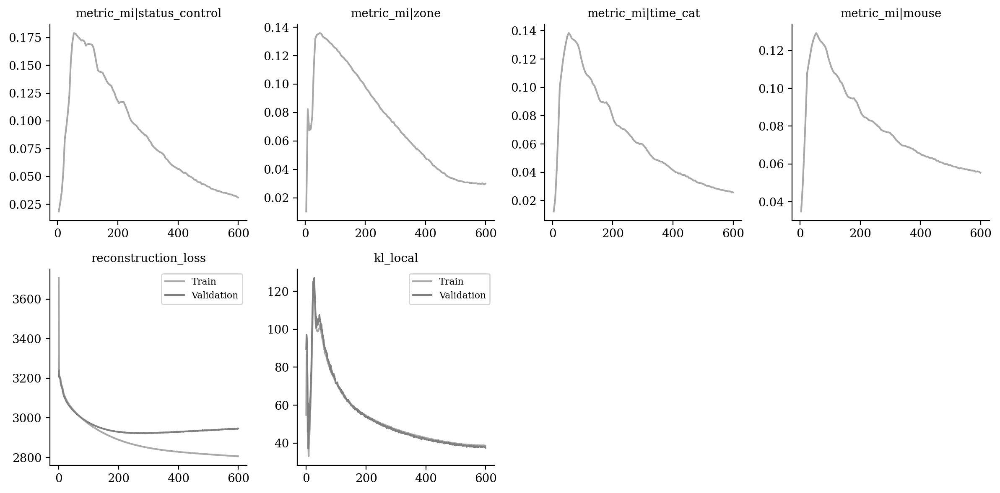

In [12]:
vae.plot_training_history(
    ignore_first=0,
    n_col=4,
    metrics_name=["metric_mi|status_control", "metric_mi|zone", "metric_mi|time_cat", "metric_mi|mouse",
                 "reconstruction_loss", "kl_local"]
)

In [13]:
from tardis._disentanglementmanager import DisentanglementManager as DM

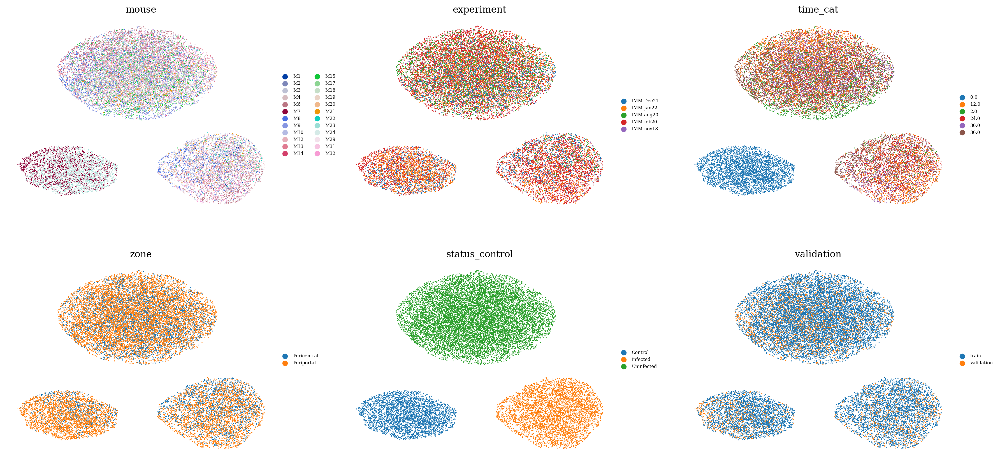

In [14]:
sublatent = DM.configurations.get_by_obs_key("status_control").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

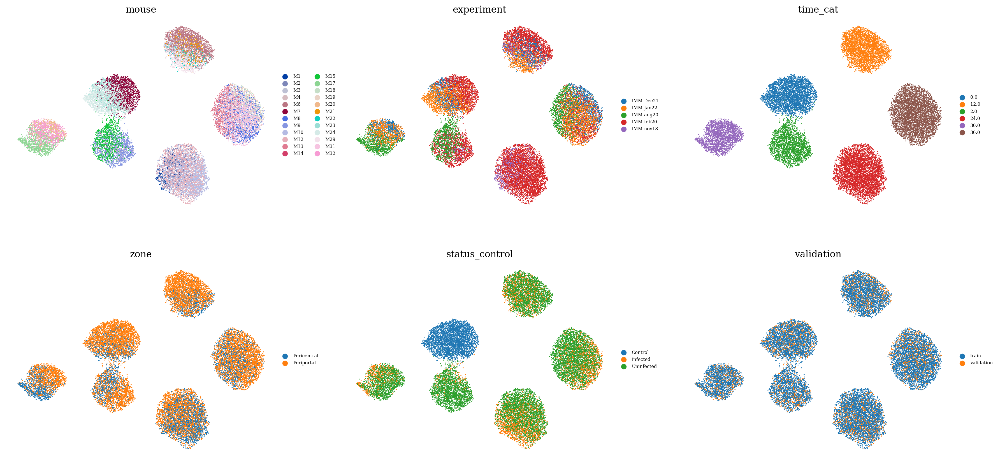

In [15]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

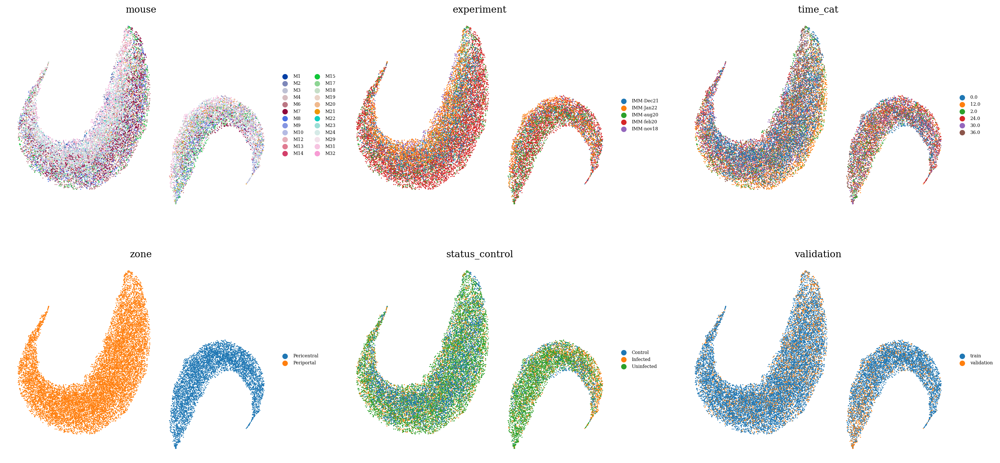

In [16]:
sublatent = DM.configurations.get_by_obs_key("zone").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

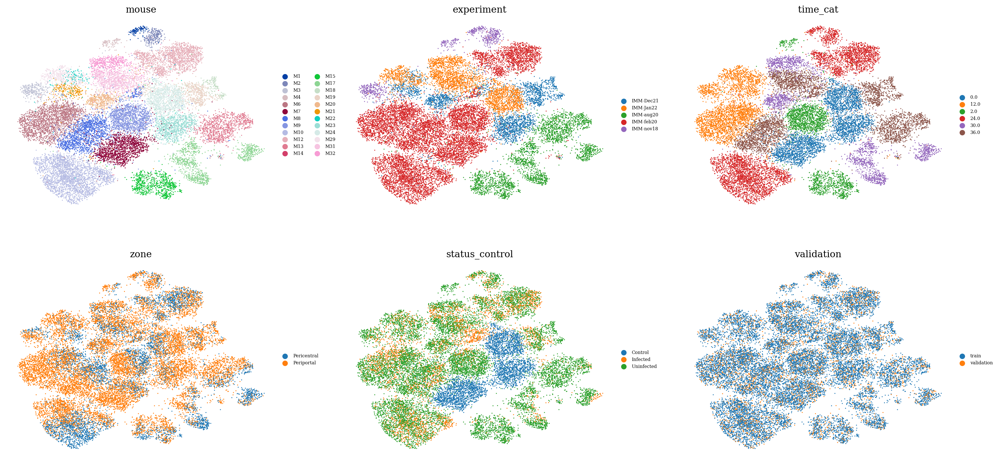

In [17]:
sublatent = DM.configurations.unreserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

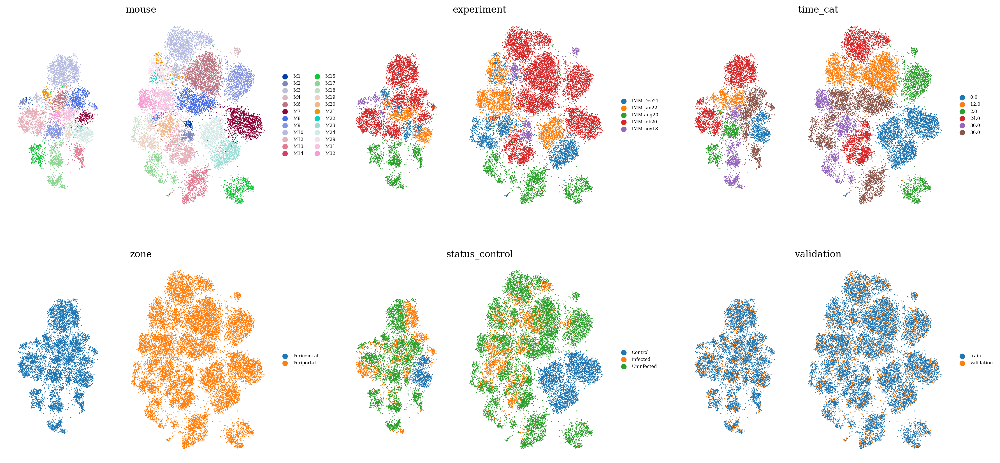

In [18]:
latent = ad.AnnData(X=vae.get_latent_representation(), obs=adata.obs.copy())
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )

In [19]:
sublatent = DM.configurations.get_by_obs_key("time_cat").reserved_latent_indices
latent = ad.AnnData(X=vae.get_latent_representation()[:, sublatent], obs=adata.obs.copy())

In [20]:
latent = latent[latent.obs["time_cat"] == "12.0"]

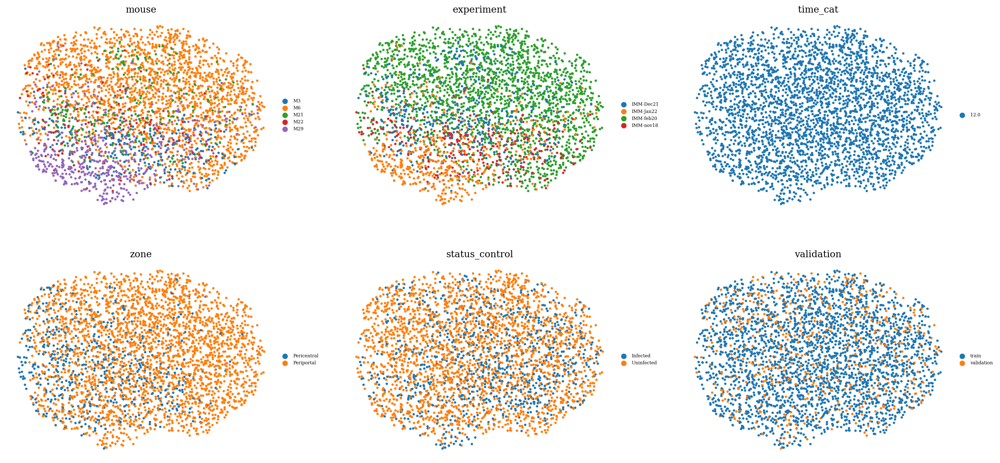

In [21]:
sc.pp.neighbors(latent)
sc.tl.umap(latent)

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    sc.pl.umap(
        latent, 
        color=['mouse', 'experiment', 'time_cat', 'zone', 'status_control', "validation"], 
        ncols=3,
        frameon=False,
        legend_fontsize="xx-small"
    )